In [5]:
import os
from pathlib import Path
if 'ESMFMKFILE' not in os.environ:
    os.environ['ESMFMKFILE'] = str(Path(os.__file__).parent.parent / 'esmf.mk')
    
import xscen as xs
import xesmf
import xarray as xr
import xclim as xc
from xclim.sdba import loess

import dask
from dask.distributed import Client

import numpy as np
import pandas as pd
import string

import figanos.matplotlib as fg
fg.utils.set_mpl_style('ouranos')

import matplotlib
from matplotlib import pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import seaborn as sns


from xscen import CONFIG
path = 'config/path_part.yml'
config = 'config/config_part.yml'
xs.load_config(path, config, verbose=(__name__ == '__main__'), reset=True)

pcat = xs.ProjectCatalog(CONFIG['project_catalog']['path'])
tdd=CONFIG['tdd']
daskkws = CONFIG['dask'].get('client', {})
ens_name = CONFIG['ens_name'] 
ens_name='11444'# TODO: remove

categories={'scenario':'SSP','model':'GCM','reference':'reference','variability':'variability','adjustment':'method', 'total':'total'}
cmaps={'dry_days':'prec_seq',
      'r20mm':'prec_seq',
      'rx1day':'prec_seq',
       'prcptot': "prec_seq",
      'tg_mean':'temp_seq',
      'tx_30':'temp_seq',
      'tx_max':'temp_seq',
      'dlyfrzthw':'misc_seq_3',
      'solidprcptot':'misc_seq_2',
      'heat_wave_total_length':'temp_seq'}
units={'dry_days':'days',
      'r20mm':'days',
      'rx1day':'mm',
       'prcptot': "mm",
      'tg_mean':'K',
      'tx_30':'days',
      'tx_max':'K',
      'dlyfrzthw':'days',
      'solidprcptot':'mm',
      'heat_wave_total_length':'days'}

from pathlib import Path
Path(CONFIG['paths']['figures']).mkdir(parents=True, exist_ok=True)

/exec/jlavoie/.conda/envs/partition/lib/python3.12/site-packages/xclim/sdba.py:12: UserWarning: The `xclim.sdba` module has been split into its own package `xsdba`. Users are encouraged to use `xsdba` directly. For the time being, `xclim.sdba` will import `xsdba` to allow for API compatibility. This behaviour may change in the future. For more information, see: https://xsdba.readthedocs.io/en/stable/xclim_migration_guide.html


# matrix

/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "None" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "units" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "long_name" not found.


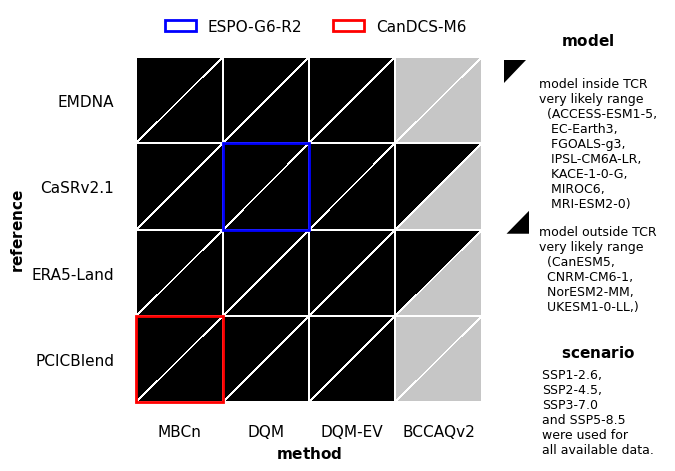

In [2]:
import matplotlib.patches as mpatches
from matplotlib.tri import Triangulation
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.patches as patches

inside=["ACCESS-ESM1-5", "EC-Earth3", "FGOALS-g3", "IPSL-CM6A-LR", "KACE-1-0-G", "MIROC6", "MRI-ESM2-0"]
outside=["CNRM-CM6-1","NorESM2-MM","UKESM1-0-LL", "CanESM5"]    
references=['EMDNA','CaSRv2.1','ERA5-Land', 'PCICBlend',  ]
methods=['MBCn', 'DQM', 'DQM-EV','BCCAQv2' ]

valuesP=[]
for source in [inside,outside]:
    data= np.zeros((len(references),len(methods)))
    for i,re in enumerate(references):
        for j,m in enumerate(methods):
            l = len(pcat.search(source=source,domain='QC', reference=re, processing_level='indicators',
                                          adjustment=m.replace('DQM-EV','IC6').replace('DQM','ESPO-G6',)).df)
            data[i,j]=1 if l == len(source)*4*10 else 0 # * exp * variable
            #print(re, m, 1 if l == len(source)*4*10 else 0)
    valuesP.append(data)
#valuesP[1][0,0]=1 #TODO: remove
#print(valuesP)
ds= xr.DataArray(data=np.array(valuesP), dims=['source','method','reference',], coords=dict(
    reference=references,
    method=methods,
    source=['inside', 'outside']
))
ax=fg.triheatmap(ds, z='source', cbar=False, cmap='Greys', plot_kw={'vmin':-0.5})


ax.tick_params("y", rotation=0)
ax.tick_params("x", rotation=0)

# Create a Rectangle patch
rect1 = patches.Rectangle((1,1), 1,1, linewidth=2, edgecolor='blue', facecolor='none', label='ESPO-G6-R2')
#rect2 = patches.Rectangle((-0.5,2.5), 1,1, linewidth=1, edgecolor='orange', facecolor='none', label='CanDCS-U6')
rect3 = patches.Rectangle((0,3), 1,1, linewidth=2, edgecolor='red', facecolor='none', label='CanDCS-M6')
rect4 = patches.Rectangle((1,2), 1,1, linewidth=2, edgecolor='cyan', facecolor='none', label='ESPO-G6-E5L')

# Add the patch to the Axes
plt.gca().add_patch(rect1)
#plt.gca().add_patch(rect4)
#ax.add_patch(rect2)
plt.gca().add_patch(rect3)

class DoubleTriangle:
    def __init__(self, color, side):
        self.color=color
        self.side=side

class DoubleTriangleHandler:
    def legend_artist(self, legend, orig_handle, fontsize, handlebox):
        x, y = handlebox.xdescent, handlebox.ydescent
        w, h = handlebox.width, handlebox.height+12
        gap = h /10
        if orig_handle.side=='left':
            triangle = mpatches.Polygon([[x, y + gap], [x, y + h], [x + w - gap, y + h]],
                                             facecolor=orig_handle.color,
                                             #edgecolor='white', lw=1, 
                                        transform=handlebox.get_transform())
        else:
            triangle = mpatches.Polygon([[x + gap, y], [x + w, y + h - gap], [x + w, y]],
                                              facecolor=orig_handle.color,
                                              #edgecolor='white', lw=1,
                                        transform=handlebox.get_transform())
        handlebox.add_artist(triangle)
        return triangle
plt.margins(x=0.05, y=0.05)
plt.rcParams['text.usetex'] = False
leg1=plt.legend([DoubleTriangle('black', 'left'), DoubleTriangle('black', 'rigth')],
           [#r'a\\{\scriptsize b}',
               #r'$a$\n$\mathit{\small b}$',
            "model inside TCR \nvery likely range \n  (ACCESS-ESM1-5,\n   EC-Earth3,\n   FGOALS-g3,\n   IPSL-CM6A-LR,\n   KACE-1-0-G,\n   MIROC6,\n   MRI-ESM2-0)",
            #r"GCM inside the TCR \\ very likely range \\ {\small(ACCESS-ESM1-5,\\  EC-Earth3,\\  FGOALS-g3,\\  IPSL-CM6A-LR,\\  KACE-1-0-G,\\  MIROC6,\\  MRI-ESM2-0)}",
            'model outside TCR \nvery likely range \n  (CanESM5, \n  CNRM-CM6-1,\n  NorESM2-MM,\n  UKESM1-0-LL,)'],
                bbox_to_anchor=(1,1.08), labelspacing=3,fontsize=9, borderaxespad=0,#borderpad=-5, 
           handler_map={DoubleTriangle: DoubleTriangleHandler()})
#plt.legend(handletextpad=-1)
for t in leg1.get_texts():
   t.set_verticalalignment("center")

# for i in range(4):
#     for j in range(4):
#         plt.plot(i,j,'.', color=
plt.figtext(0.93,0.9, r'$\bf{model}$')
plt.figtext(0.93,0.25, r'$\bf{scenario}$')
plt.figtext(0.9,0.05,'SSP1-2.6, \nSSP2-4.5,\nSSP3-7.0\nand SSP5-8.5 \nwere used for\nall available data.',fontsize=9,)

plt.xlabel(r'$\bf{method}$')
plt.ylabel(r'$\bf{reference}$')
#ESPO legend
#plt.legend(bbox_to_anchor=(0.98,0.9))
plt.legend(bbox_to_anchor=(0.95, 1.09), ncol=2)
plt.gca().add_artist(leg1)
#plt.title('SSP2-4.5, SSP3-7.0 and SSP5-8.5 were used for all available data.')
plt.tight_layout()
plt.savefig(f"{CONFIG['paths']['figures']}/main/matrix.pdf", bbox_inches='tight')


# example timeseries

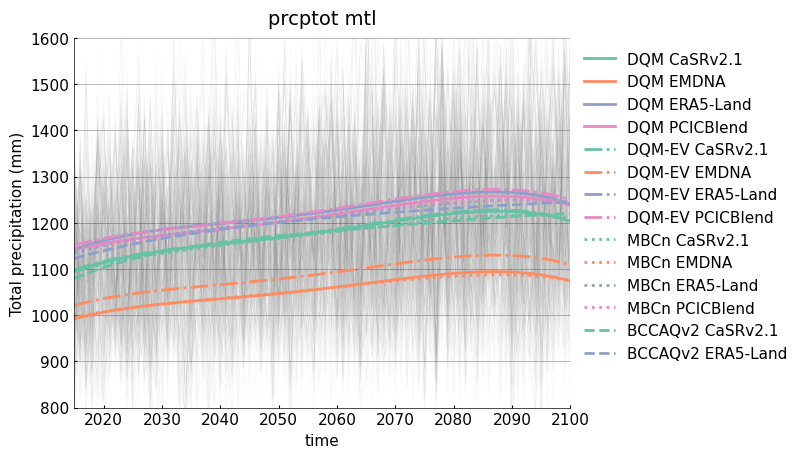

/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/dask/array/numpy_compat.py:57: RuntimeWarning: invalid value encountered in divide
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/dask/array/numpy_compat.py:57: RuntimeWarning: invalid value encountered in divide
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/dask/array/numpy_compat.py:57: RuntimeWarning: invalid value encountered in divide
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/dask/array/numpy_compat.py:57: RuntimeWarning: invalid value encountered in divide
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/dask/array/numpy_compat.py:57: RuntimeWarning: invalid value encountered in divide
/exec/easybuild/software/2023/

In [3]:

ens_part=pcat.search(processing_level=f'partition-ensemble{ens_name}', variable='prcptot', domain='mtl'
                    ).to_dataset(**tdd)

cmap=sns.color_palette("Set2", as_cmap=True)
n_colors=4

fig=plt.figure()
da=ens_part['prcptot']
fit = da.polyfit(dim="time", deg=4, skipna=True)
sm = xr.polyval(coord=da.time, coeffs=fit.polyfit_coefficients).where(da.notnull())

for a in ['ESPO-G6','IC6','MBCn','BCCAQv2']:
    for r in ['CaSRv2.1','EMDNA','ERA5-Land','PCICBlend']:
        for s in ens_part.scenario.values:
            for m in ens_part.model.values:
                da.sel(adjustment=a,reference=r, scenario=s, model=m).plot(x="time", color='grey',
                                                                           linewidth=0.1, alpha=0.08)

for a, al in zip(['ESPO-G6','IC6','MBCn','BCCAQv2'],['-','-.',':','--']):
    for r, rc in zip(['CaSRv2.1','EMDNA','ERA5-Land','PCICBlend'],[cmap(i) for i in range(n_colors)]):
        if not (a=='BCCAQv2' and r in ['EMDNA','PCICBlend']):
            cur = sm.sel(adjustment=a,reference=r).mean(dim=['model','scenario'])
            cur.plot(color=rc,linestyle=al, label=f"{a} {r}".replace('ESPO-G6','DQM').replace('IC6','DQM-EV'),linewidth=2)
            
            
plt.legend(bbox_to_anchor=(1,1))
plt.title('prcptot mtl')
plt.ylabel('Total precipitation (mm)')
plt.ylim((800,1600))

#fig.savefig(f"{CONFIG['paths']['figures']}ts_prcptot_example.png", bbox_inches='tight')
fig.savefig(f"{CONFIG['paths']['figures']}/main/ts_prcptot_example.pdf", bbox_inches='tight')


# partition grid points


--> The keys in the returned dictionary of datasets are constructed as follows:
	'id.domain.processing_level.xrfreq'


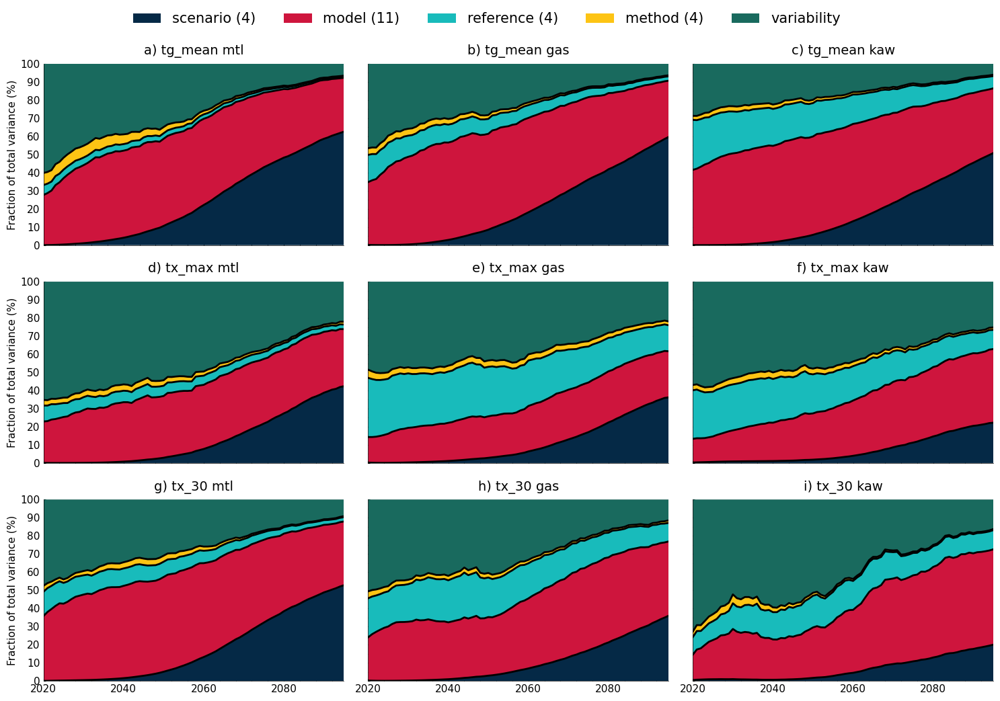

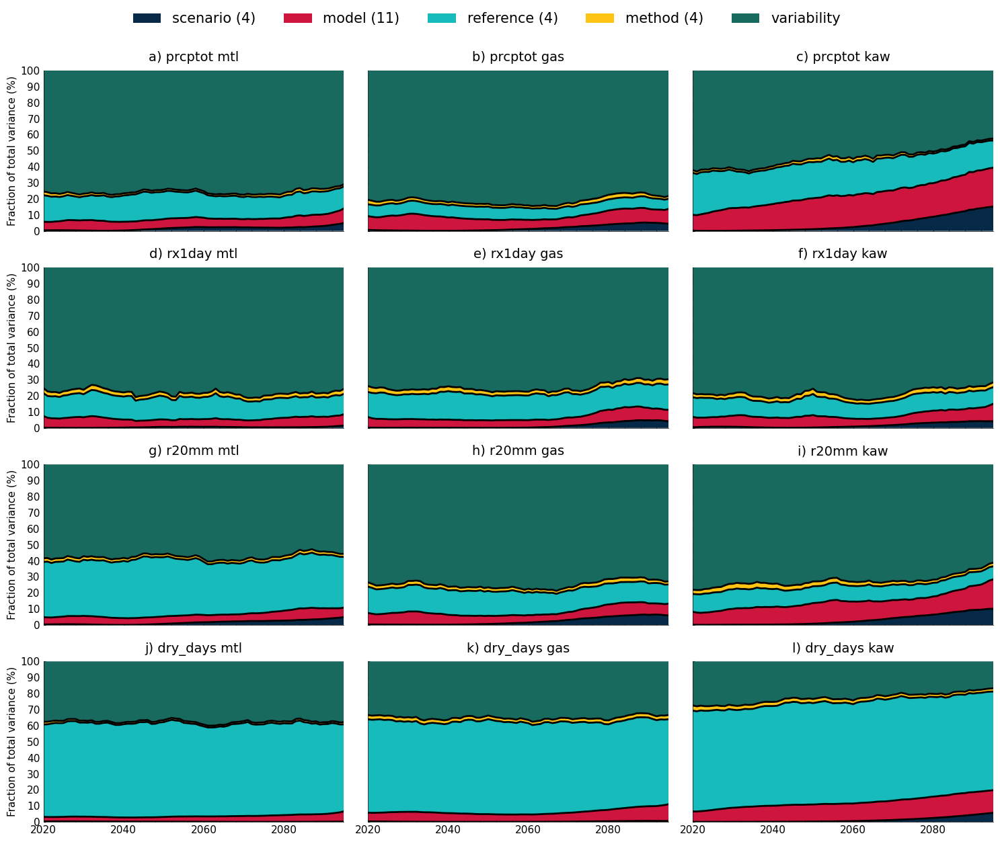

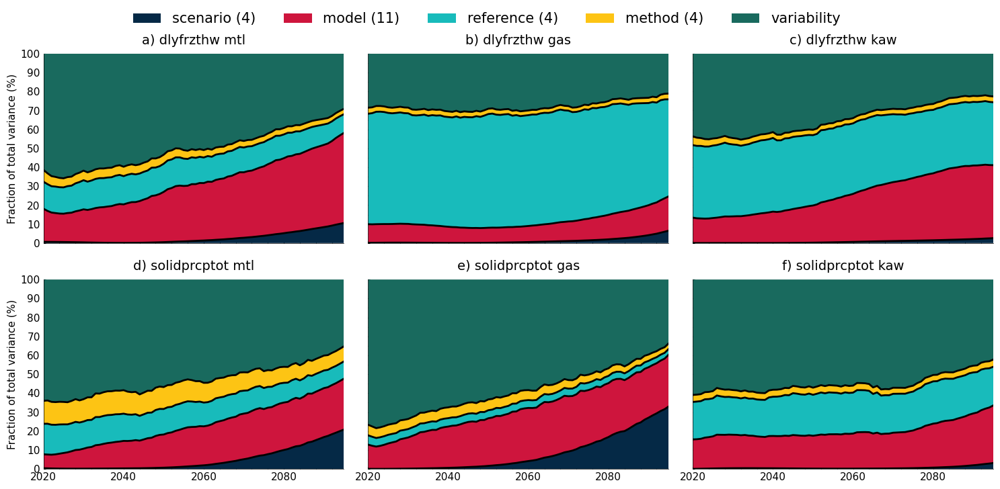

In [4]:
ens_name='11444'
#switch purple and green
matplotlib.rcParams['axes.prop_cycle'] = matplotlib.cycler(color=['#052946', '#ce153d', '#18bbbb', '#fdc414','#196a5e', '#6850af',  '#7a5315']) 

d_wrongorder=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain=['mtl','gas','kaw'] ).to_dataset_dict(**tdd)

#fix names
for k,v in d_wrongorder.items():
        v['uncertainty']=[categories[x] for x in v['uncertainty'].values]
        for c in categories:
            for var in v.data_vars:
                if c in v[var].attrs:
                    v[var].attrs[categories[c]]=v[var].attrs[c]
#fix order
d={f'CMIP6_ScenarioMIP_mtl.mtl.uncertainties{ens_name}-poly-2015.YS-JAN':d_wrongorder[f'CMIP6_ScenarioMIP_mtl.mtl.uncertainties{ens_name}-poly-2015.YS-JAN'],
   f'CMIP6_ScenarioMIP_gas.gas.uncertainties{ens_name}-poly-2015.YS-JAN':d_wrongorder[f'CMIP6_ScenarioMIP_gas.gas.uncertainties{ens_name}-poly-2015.YS-JAN'],
       f'CMIP6_ScenarioMIP_kaw.kaw.uncertainties{ens_name}-poly-2015.YS-JAN':d_wrongorder[f'CMIP6_ScenarioMIP_kaw.kaw.uncertainties{ens_name}-poly-2015.YS-JAN'],

  }
fig, axs= plt.subplots(3,3, figsize=(15,10), sharex=True, sharey=True)
for i, (id, ds) in enumerate(d.items()):
    domain=ds.attrs['cat:domain']
    for j, var in enumerate(['tg_mean','tx_max','tx_30']):
        frac= xc.ensembles.fractional_uncertainty(ds[var])

#             frac
        fg.partition(frac,show_num=True,ax=axs[j,i])
        axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {domain}")
        axs[j,i].get_legend().remove()
        axs[j,1].set_ylabel('')
        axs[j,2].set_ylabel('')
    
handles, labels = axs[j,i].get_legend_handles_labels()
labels=[x.replace('SSP','scenario').replace('GCM','model') for x in labels] # for reviewer
by_label = dict(zip(labels, handles)).copy()
fig.legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.85,1.05), ncol=5, fontsize=15)
fig.tight_layout()
#fig.savefig(f"{CONFIG['paths']['figures']}tas_unc.png", bbox_inches='tight')
fig.savefig(f"{CONFIG['paths']['figures']}/main/tas_unc.pdf", bbox_inches='tight')


fig, axs= plt.subplots(4,3, figsize=(15,12), sharex=True, sharey=True)
for i, (id, ds) in enumerate(d.items()):
    domain=ds.attrs['cat:domain']
    for j, var in enumerate(['prcptot','rx1day', 'r20mm','dry_days']):
        frac= xc.ensembles.fractional_uncertainty(ds[var])
        fg.partition(frac,show_num=True,ax=axs[j,i])
        axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {domain}")
        axs[j,i].get_legend().remove()
        axs[j,1].set_ylabel('')
        axs[j,2].set_ylabel('')
    
handles, labels = axs[j,i].get_legend_handles_labels()
labels=[x.replace('SSP','scenario').replace('GCM','model') for x in labels] # for reviewer
by_label = dict(zip(labels, handles)).copy()
fig.legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.85,1.05), ncol=5, fontsize=15)
fig.tight_layout()
#fig.savefig(f"{CONFIG['paths']['figures']}pr_unc.png", bbox_inches='tight')
fig.savefig(f"{CONFIG['paths']['figures']}/main/pr_unc.pdf", bbox_inches='tight')


fig, axs= plt.subplots(2,3, figsize=(15,7), sharex=True, sharey=True)
for i, (id, ds) in enumerate(d.items()):
    domain=ds.attrs['cat:domain']
    for j, var in enumerate(['dlyfrzthw','solidprcptot']): #
        frac= xc.ensembles.fractional_uncertainty(ds[var])
        fg.partition(frac,show_num=True,ax=axs[j,i])
        axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {domain}")
        axs[j,i].get_legend().remove()
        axs[j,1].set_ylabel('')
        axs[j,2].set_ylabel('')
        
handles, labels = axs[j,i].get_legend_handles_labels()
labels=[x.replace('SSP','scenario').replace('GCM','model').replace('GCM','model') for x in labels] # for reviewer
by_label = dict(zip(labels, handles)).copy()
fig.legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.85,1.05), ncol=5, fontsize=15)
fig.tight_layout()
#fig.savefig(f"{CONFIG['paths']['figures']}multi_unc.png", bbox_inches='tight')
fig.savefig(f"{CONFIG['paths']['figures']}/main/multi_unc.pdf", bbox_inches='tight')

In [5]:

for j, var in enumerate(['tg_mean','tx_max','tx_30','prcptot','rx1day', 'r20mm','dry_days','dlyfrzthw','solidprcptot']):
    print('')
    print(var)
    for d in ['mtl','gas','kaw']:
        print(d)
        #ens_name = '7443' if var in ['tg_mean','tx_max','tx_30','dlyfrzthw',] else '11443'
        ens_name='11444'
        ds=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain=d, variable=var ).to_dataset(**tdd)
        frac= xc.ensembles.fractional_uncertainty(ds[var])
        for u in frac.uncertainty.values:
            print(u, round(float(frac.sel(uncertainty=u).min(dim='time').values),1),round(float(frac.sel(uncertainty=u).mean(dim='time').values),1), round(float(frac.sel(uncertainty=u).max(dim='time').values),1))
        print('sma', round(float(frac.sel(uncertainty=['scenario', 'model','adjustment']).mean(dim=['time', 'uncertainty']).values),1))


tg_mean
mtl
scenario 0.0 24.3 62.6
model 27.6 42.0 49.2
reference 0.7 2.6 5.5
adjustment 0.5 3.1 6.7
variability 6.6 28.0 60.2
total 100.0 100.0 100.0
sma 23.1
gas
scenario 0.0 20.9 59.6
model 31.0 46.7 55.6
reference 2.4 7.6 15.0
adjustment 0.6 2.0 3.9
variability 6.4 22.9 46.6
total 100.0 100.0 100.0
sma 23.2
kaw
scenario 0.0 16.6 50.8
model 35.7 48.6 55.3
reference 6.8 16.4 27.5
adjustment 0.7 1.7 2.9
variability 6.0 16.7 28.7
total 100.0 100.0 100.0
sma 22.3

tx_max
mtl
scenario 0.0 12.7 42.3
model 22.8 33.0 36.9
reference 2.5 5.2 8.8
adjustment 1.1 2.3 3.5
variability 22.1 46.7 65.3
total 100.0 100.0 100.0
sma 16.0
gas
scenario 0.1 10.6 36.2
model 14.1 23.6 28.2
reference 14.3 24.3 32.6
adjustment 2.1 3.1 4.5
variability 21.4 38.4 50.4
total 100.0 100.0 100.0
sma 12.4
kaw
scenario 0.3 7.0 22.2
model 13.0 28.6 40.6
reference 10.6 19.3 26.8
adjustment 1.2 2.5 3.7
variability 25.2 42.6 58.3
total 100.0 100.0 100.0
sma 12.7

tx_30
mtl
scenario 0.0 17.9 52.8
model 35.2 46.5 52.9
refer

In [6]:

for j, var in enumerate(['tg_mean','tx_max','tx_30','prcptot','rx1day', 'r20mm','dry_days','dlyfrzthw','solidprcptot']):
    print('')
    print('\n')
    print(var)
    for d in ['mtl','gas','kaw']:
        print(d)
        #ens_name = '7443' if var in ['tg_mean','tx_max','tx_30','dlyfrzthw',] else '11443'
        ens_name='11444'
        ds=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain=d, variable=var ).to_dataset(**tdd)
        frac= xc.ensembles.fractional_uncertainty(ds[var])
        for t in ['2020','2090']:
            print(t)
            cur=frac.sel(time=t).squeeze()
            out=cur.sortby(cur, ascending=False)
            print(out.uncertainty.values)
            print(out.values)





tg_mean
mtl
2020
['total' 'variability' 'model' 'adjustment' 'reference' 'scenario']
[1.00000000e+02 6.02039696e+01 2.76450976e+01 6.65085590e+00
 5.49018863e+00 9.88819071e-03]
2090
['total' 'scenario' 'model' 'variability' 'reference' 'adjustment']
[100.          58.6353957   32.39189684   7.6531557    0.81646656
   0.5030852 ]
gas
2020
['total' 'variability' 'model' 'reference' 'adjustment' 'scenario']
[100.          46.56976517  34.62121447  15.0280214    3.65052254
   0.13047642]
2090
['total' 'scenario' 'model' 'variability' 'reference' 'adjustment']
[100.          53.64654125  34.79113643   8.05668307   2.88407655
   0.6215627 ]
kaw
2020
['total' 'model' 'variability' 'reference' 'adjustment' 'scenario']
[1.00000000e+02 4.14680548e+01 2.87200653e+01 2.75446177e+01
 2.23768815e+00 2.95740542e-02]
2090
['total' 'scenario' 'model' 'reference' 'variability' 'adjustment']
[100.          45.38052146  38.49391828   7.85220071   7.49954474
   0.77381481]



tx_max
mtl
2020
['total' '

In [7]:

for j, var in enumerate(['tg_mean','tx_max','tx_30','prcptot','rx1day', 'r20mm','dry_days','dlyfrzthw','solidprcptot']):
    print('')
    print(var)
    for d in ['mtl','gas','kaw']:
        print(d)
        #ens_name = '7443' if var in ['tg_mean','tx_max','tx_30','dlyfrzthw',] else '11443'
        ens_name='7442'
        ds=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain=d, variable=var ).to_dataset(**tdd)
        frac= xc.ensembles.fractional_uncertainty(ds[var])
        for u in frac.uncertainty.values:
            print(u, round(float(frac.sel(uncertainty=u).min(dim='time').values),1),round(float(frac.sel(uncertainty=u).mean(dim='time').values),1), round(float(frac.sel(uncertainty=u).max(dim='time').values),1))
        print('sma', round(float(frac.sel(uncertainty=['scenario', 'model','adjustment']).mean(dim=['time', 'uncertainty']).values),1))


tg_mean
mtl
scenario 0.0 8.9 41.4
model 22.2 36.3 43.6
reference 2.1 4.3 5.6
adjustment 1.3 4.3 7.7
variability 21.0 46.2 66.4
total 100.0 100.0 100.0
sma 16.5
gas
scenario 0.0 6.9 32.7
model 32.4 47.5 53.4
reference 5.6 10.0 13.2
adjustment 0.9 2.3 3.6
variability 17.5 33.1 52.5
total 100.0 100.0 100.0
sma 18.9
kaw
scenario 0.0 4.3 21.1
model 44.7 53.1 57.6
reference 13.2 19.6 24.3
adjustment 1.0 1.9 3.0
variability 13.8 21.0 28.6
total 100.0 100.0 100.0
sma 19.8

tx_max
mtl
scenario 0.0 2.5 13.1
model 19.4 30.3 38.5
reference 4.8 6.1 9.4
adjustment 3.3 4.3 5.5
variability 39.7 56.7 67.8
total 100.0 100.0 100.0
sma 12.4
gas
scenario 0.0 1.4 7.3
model 12.2 21.5 28.8
reference 24.5 27.3 33.7
adjustment 4.0 5.0 6.0
variability 34.2 44.8 53.9
total 100.0 100.0 100.0
sma 9.3
kaw
scenario 0.0 0.6 3.2
model 11.9 24.7 39.4
reference 14.5 20.9 24.6
adjustment 2.1 4.7 7.6
variability 40.6 49.1 59.5
total 100.0 100.0 100.0
sma 10.0

tx_30
mtl
scenario 0.0 4.8 22.3
model 34.9 49.2 55.5
reference

# partition maps

/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "units" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "long_name" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "long_name" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/xesmf/frontend.py:95: UserWarning: Variables {'lon_bounds'} not found in object but are referred to in the CF attributes.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/xesmf/frontend.py:95: UserWarning: Variables {'lon_bounds'} not found in object but are re

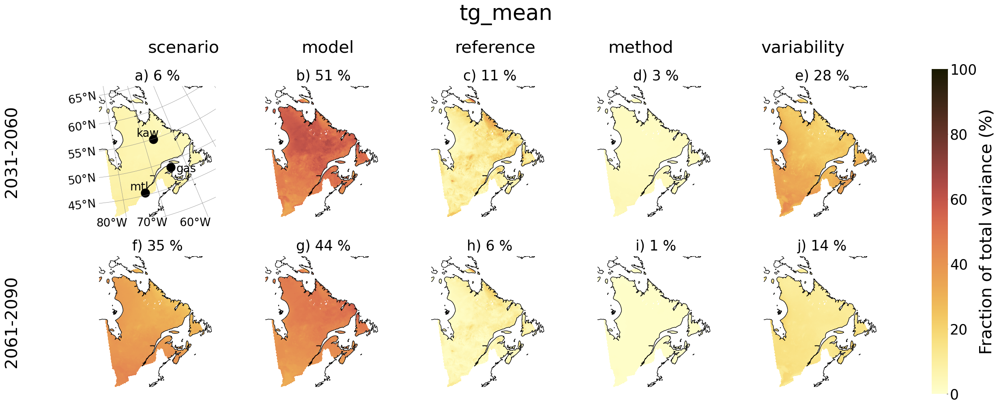

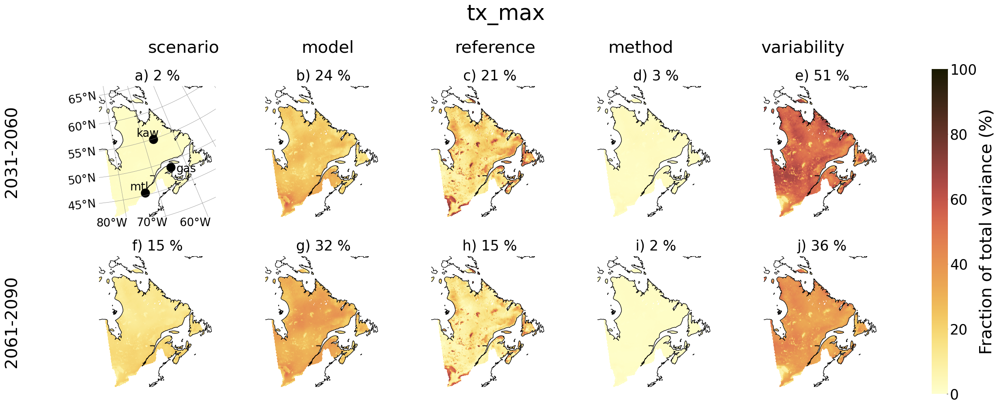

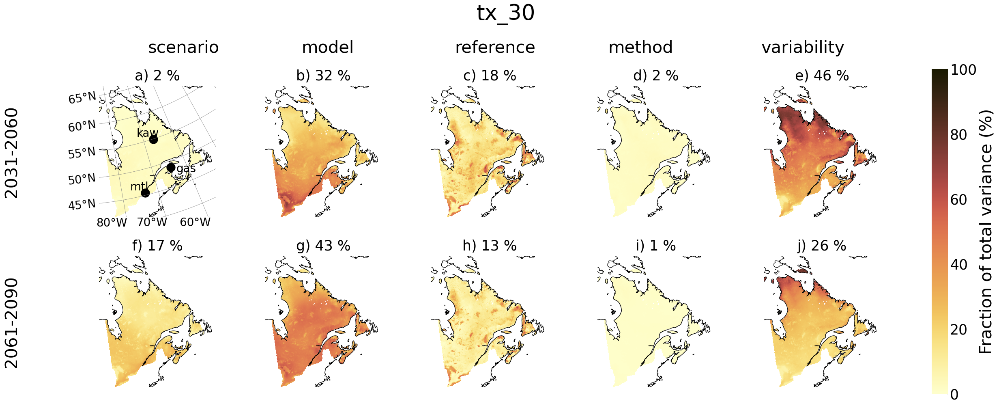

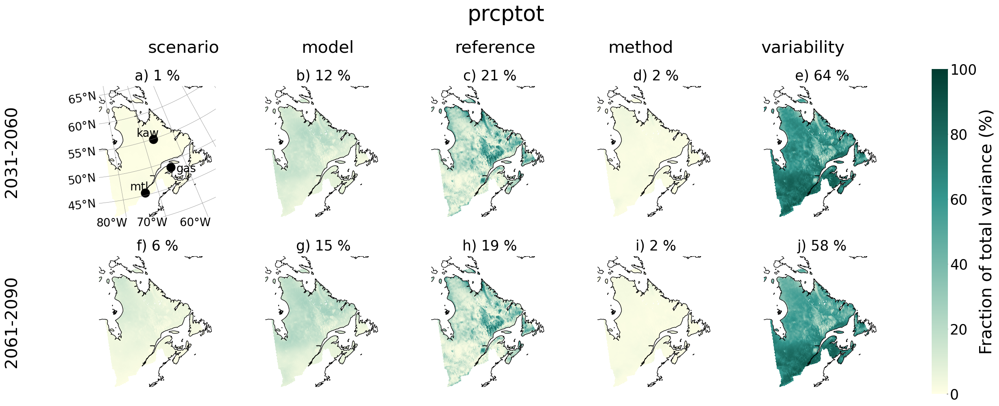

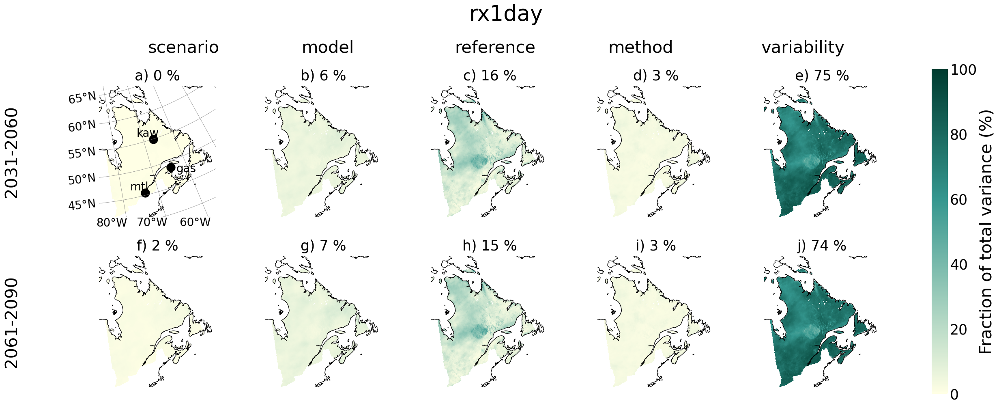

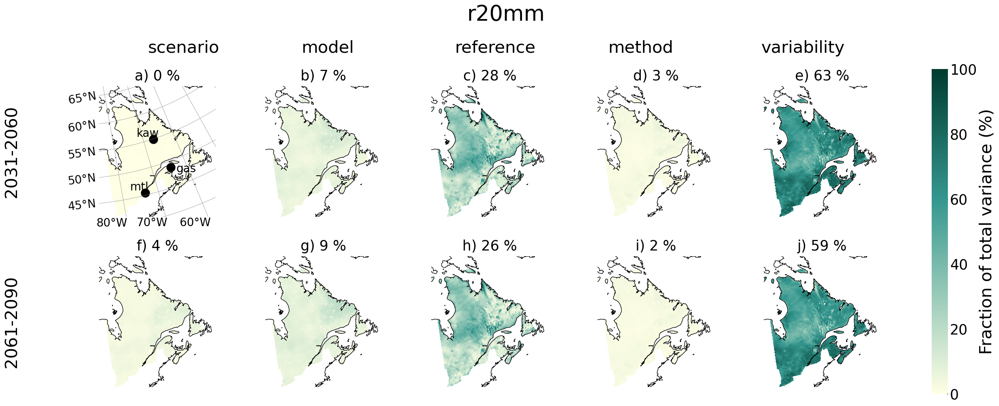

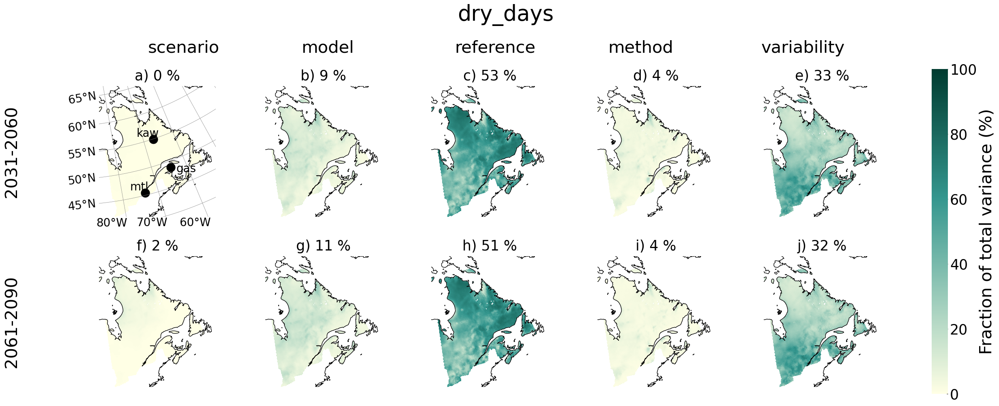

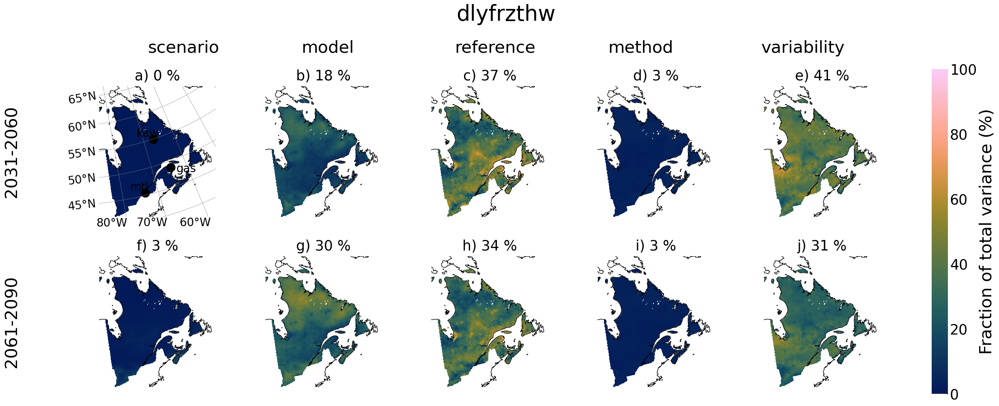

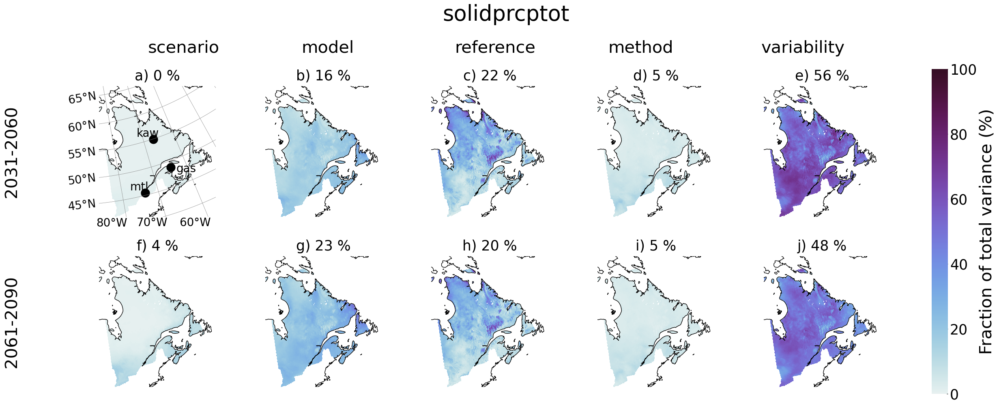

In [8]:
with Client(n_workers=3, threads_per_worker=5, memory_limit="8GB", **daskkws):
    for var in ['tg_mean','tx_max','tx_30','prcptot','rx1day', 'r20mm','dry_days','dlyfrzthw','solidprcptot']:
        #ens_name = '7443' if var in ['tg_mean','tx_max','tx_30','dlyfrzthw',] else '11443'
        ens_name='11444'
        ds=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain='QC-reg1c', variable=var).to_dataset(**tdd)
        ds['uncertainty']=[categories[x] for x in ds['uncertainty'].values]
        frac= xc.ensembles.fractional_uncertainty(ds).drop_sel(uncertainty='total')
        frac=xs.climatological_op(frac,op='mean', periods=[['2031','2060'],['2061','2090']],
                                 rename_variables=False, horizons_as_dim=True)#.compute()
        frac.lat.attrs['axis']='Y'
        frac.lon.attrs['axis']='X'
        frac.lat.attrs['axis']='Y'
        frac.lon.attrs['axis']='X'
        frac.lat.attrs['long_name'] = "latitude"
        frac.lat.attrs['standard_name'] = "latitude"
        frac.lon.attrs['long_name'] = "longitude"
        frac.lon.attrs['standard_name'] = "longitude"
        grid=fg.gridmap(frac[var],
                      features={'coastline':{},
                               },
                      cmap=cmaps[var],
                      projection=ccrs.LambertConformal(),
                      plot_kw={'col':'uncertainty','row':'horizon', 'vmin':0, 'vmax':100, #'figsize':(15,10),
                               'size':4, "aspect":1,
                               'cbar_kwargs':{'shrink':0.85},
                              },
                       )
        plt.subplots_adjust(hspace=0.3)
        grid.fig.suptitle(f"{var}",x=0.55, y=1.2, fontsize=38)
        y=1.05
        x=0.13
        dx=0.18
        means=[]
        for j,h in enumerate(frac.horizon.values):
            for i,t in enumerate(['SSP','GCM','reference','method','variability']):
                if j ==0:
                    grid.fig.text(s=t.replace('SSP','scenario').replace('GCM','model'),x=x+ i*dx, y=y, fontsize=30)
            
                spa_mean = xs.spatial_mean(frac[[var]].sel(uncertainty=t, horizon=h),method='xesmf',
                                           kwargs={'skipna':True},
                                          region= {'name': 'QC-mean','method': 'bbox',
                                                   'lon_bnds': [ -83, -55 ],'lat_bnds': [ 42, 63 ]})
                means.append("{:.0f} %".format(spa_mean[var].values))
        grid.cbar.set_label('Fraction of total variance (%)', fontsize=30)
        grid.cbar.ax.tick_params(labelsize=25)
        grid.cbar.ax.set_position([1.05, 0, 0.03, 1])

        # move labels to the left
        for i, fax in enumerate(grid.axs.flat):
            for txt in fax.texts:
                if len(txt.get_text()) > 0:
                    txt.set_x(-6.5)
                    txt.set_fontsize(30)
                    txt.set_rotation('vertical')
        for idx, ax in enumerate(grid.axs.flat):
            ax.set_title(f"{string.ascii_lowercase[idx]}) {means[idx]}", fontsize=25)

        grid.axs[0][0].plot(-73.6, 45.5, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-77.6, 46.6, 'mtl', fontsize=20, transform=ccrs.PlateCarree())
        grid.axs[0][0].plot(-64.5, 48.8, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-63.5, 47.56, 'gas', fontsize=20, transform=ccrs.PlateCarree())
        grid.axs[0][0].plot(-66.8, 54.9, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-71.9, 56.3, 'kaw', fontsize=20, transform=ccrs.PlateCarree())
        
        #grid.axs[0][0].set_extent([-80,-60, 45, 61], crs=ccrs.PlateCarree())

        gl=grid.axs[0][0].gridlines( draw_labels=True,color='gray',x_inline=False, y_inline=False)
        gl.xlabel_style = {'size': 20, 'rotation':0}
        gl.ylabel_style = {'size': 20}
        gl.top_labels = False
        gl.right_labels = False

        if var in ['tx_max', 'prcptot','dlyfrzthw']:
                    grid.fig.savefig(f"{CONFIG['paths']['figures']}/main/maps_{var}.pdf", bbox_inches='tight')
        else:
            grid.fig.savefig(f"{CONFIG['paths']['figures']}/si/maps_{var}.png", bbox_inches='tight')



/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "units" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "long_name" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "long_name" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/xesmf/frontend.py:95: UserWarning: Variables {'lon_bounds'} not found in object but are referred to in the CF attributes.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/xesmf/frontend.py:95: UserWarning: Variables {'lon_bounds'} not found in object but are re

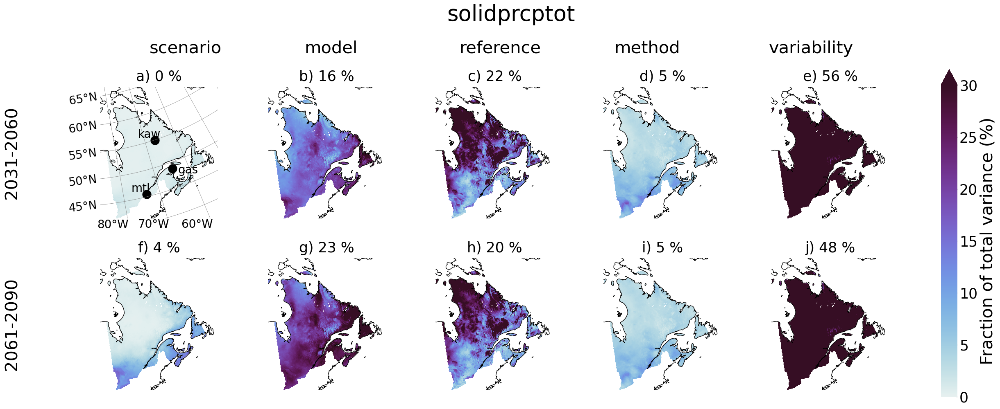

In [9]:
# adjust cbar for solidprcptot
with Client(n_workers=3, threads_per_worker=5, memory_limit="8GB", **daskkws):
    ens_name='11444'
    ds=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain='QC-reg1c').to_dataset(**tdd)
    ds['uncertainty']=[categories[x] for x in ds['uncertainty'].values]
    frac= xc.ensembles.fractional_uncertainty(ds).drop_sel(uncertainty='total')
    frac=xs.climatological_op(frac,op='mean', periods=[['2031','2060'],['2061','2090']],
                             rename_variables=False, horizons_as_dim=True)#.compute()
    frac.lat.attrs['axis']='Y'
    frac.lon.attrs['axis']='X'
    frac.lat.attrs['axis']='Y'
    frac.lon.attrs['axis']='X'
    frac.lat.attrs['long_name'] = "latitude"
    frac.lat.attrs['standard_name'] = "latitude"
    frac.lon.attrs['long_name'] = "longitude"
    frac.lon.attrs['standard_name'] = "longitude"
    #frac=xs.spatial.subset(frac, method='shape',shape="region_qc/region_qc.shp").drop_vars('crs')

    for var in ['solidprcptot']:
        grid=fg.gridmap(frac[var],
                      features={'coastline':{},
                               },
                      projection=ccrs.LambertConformal(),
                      cmap=cmaps[var],
                      plot_kw={'col':'uncertainty','row':'horizon', 'vmin':0, 'vmax':30,
                               'size':4, "aspect":1,
                               'cbar_kwargs':{'shrink':0.85},
                              },
                       )
        plt.subplots_adjust(hspace=0.3)
        grid.fig.suptitle(f"{var}",x=0.55, y=1.2, fontsize=38)
        y=1.05
        x=0.13
        dx=0.18
        means=[]
        for j,h in enumerate(frac.horizon.values):
            for i,t in enumerate(['SSP','GCM','reference','method','variability']):
                if j ==0:
                    grid.fig.text(s=t.replace('SSP','scenario').replace('GCM','model'),x=x+ i*dx, y=y, fontsize=30)
            
                spa_mean = xs.spatial_mean(frac[[var]].sel(uncertainty=t, horizon=h),method='xesmf',
                                           kwargs={'skipna':True},
                                          region= {'name': 'QC-mean','method': 'bbox',
                                                   'lon_bnds': [ -83, -55 ],'lat_bnds': [ 42, 63 ]})
                means.append("{:.0f} %".format(spa_mean[var].values))
        grid.cbar.set_label('Fraction of total variance (%)', fontsize=30)
        grid.cbar.ax.tick_params(labelsize=25)
        grid.cbar.ax.set_position([1.05, 0, 0.03, 1])


        # move labels to the left
        for i, fax in enumerate(grid.axs.flat):
            for txt in fax.texts:
                if len(txt.get_text()) > 0:
                    txt.set_x(-6.5)
                    txt.set_fontsize(30)
                    txt.set_rotation('vertical')
        for idx, ax in enumerate(grid.axs.flat):
            ax.set_title(f"{string.ascii_lowercase[idx]}) {means[idx]}", fontsize=25)

        grid.axs[0][0].plot(-73.6, 45.5, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-77.6, 46.6, 'mtl', fontsize=20, transform=ccrs.PlateCarree())
        grid.axs[0][0].plot(-64.5, 48.8, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-63.5, 47.56, 'gas', fontsize=20, transform=ccrs.PlateCarree())
        grid.axs[0][0].plot(-66.8, 54.9, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-71.9, 56.3, 'kaw', fontsize=20, transform=ccrs.PlateCarree())
        
        #grid.axs[0][0].set_extent([-80,-60, 45, 61], crs=ccrs.PlateCarree())
        #grid.axs[0][0].set_extent([-83,-55, 45, 61], crs=ccrs.PlateCarree())


        gl=grid.axs[0][0].gridlines( draw_labels=True,color='gray',x_inline=False, y_inline=False)
        gl.xlabel_style = {'size': 20, 'rotation':0}
        gl.ylabel_style = {'size': 20}
        gl.top_labels = False
        gl.right_labels = False
        #grid.fig.savefig(f"{CONFIG['paths']['figures']}maps_{var}_30.png", bbox_inches='tight')
        grid.fig.savefig(f"{CONFIG['paths']['figures']}/main/maps_{var}_30.pdf", bbox_inches='tight')


# case studies

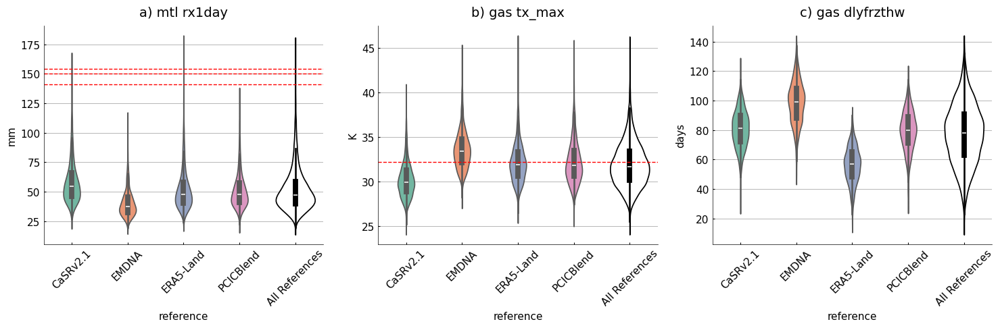

In [10]:
fig, axs = plt.subplots(1,3, figsize=(15,5), sharex=True, sharey=False)


for i, var in enumerate(['rx1day', 'tx_max', 'dlyfrzthw']):
    d='mtl' if var=='rx1day' else 'gas'
    ens_name='7442'
    ds=pcat.search(processing_level=f'partition-ensemble{ens_name}', 
                   domain=d).to_dataset(**tdd)
    ds['tx_max']=xc.core.units.convert_units_to(ds['tx_max'], 'degC')
    ds['tg_mean']=xc.core.units.convert_units_to(ds['tg_mean'], 'degC')
    ds= ds.sel(time=slice('2061','2090'))
    

    df = ds[var].to_dataframe(name=var).reset_index()


    # Plotting the violinplot
    sns.violinplot(x='reference', y=var, data=df,width=0.3, ax=axs[i],
                   order=['CaSRv2.1','EMDNA','ERA5-Land','PCICBlend'],
                   palette="Set2",
                   hue='reference',legend=False);


    df_combined = df.copy()
    df_combined['reference'] = 'All References'

    # Add the violin plot for all references on the x-axis
    sns.violinplot(
        x='reference', y=var, data=df_combined, width=0.7, ax=axs[i],
        order=['All References', 'CaSRv2.1', 'EMDNA', 'ERA5-Land', 'PCICBlend'],
        color='white', edgecolor='black', # You can adjust the color for the 'All References' violin
        legend=False
    )

    axs[i].set_title(f"{string.ascii_lowercase[i]}) {d} {var}")
    axs[i].tick_params(axis='x', rotation=45)
    axs[i].set_ylabel(units[var])

axs[1].axhline(32.2, linestyle='--', color='red',lw=1)        
axs[0].axhline(154, linestyle='--', color='red',lw=1) # MONTREAL INTL A
axs[0].axhline(141, linestyle='--', color='red',lw=1) #McTavish
axs[0].axhline(150.2, linestyle='--', color='red',lw=1) # MONTREAL/PIERRE ELLIOTT TRUDEAU INTL


fig.tight_layout()
#fig.savefig(f"{CONFIG['paths']['figures']}ref_dist.png", bbox_inches='tight')
fig.savefig(f"{CONFIG['paths']['figures']}/main/ref_dist.pdf", bbox_inches='tight')


# restricted ensemble 7442 (SI)


--> The keys in the returned dictionary of datasets are constructed as follows:
	'id.domain.processing_level.xrfreq'


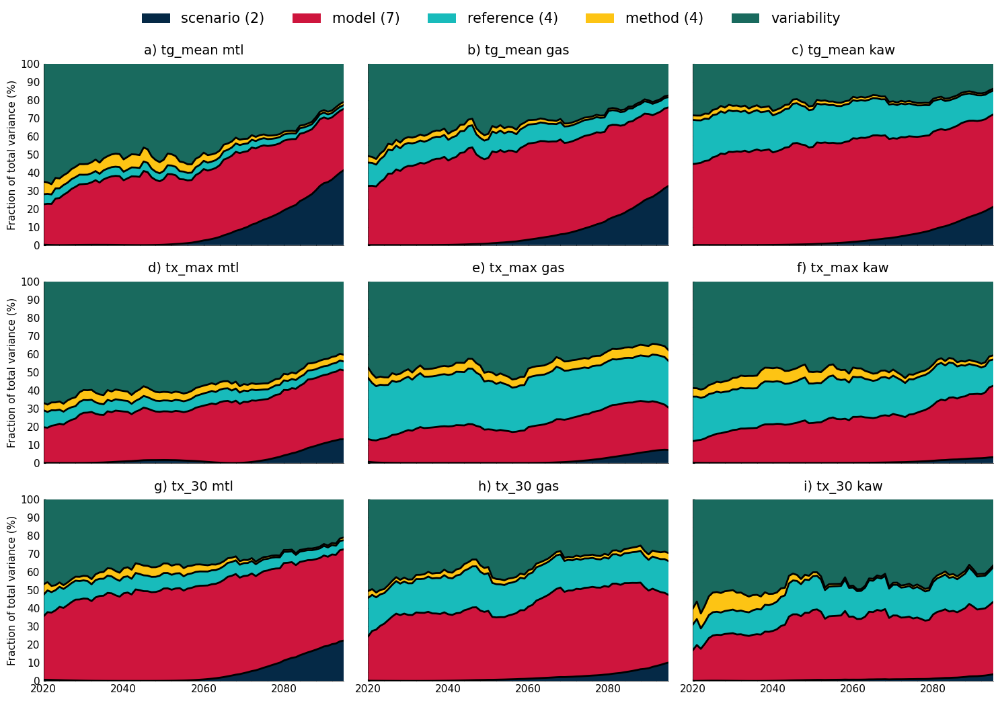

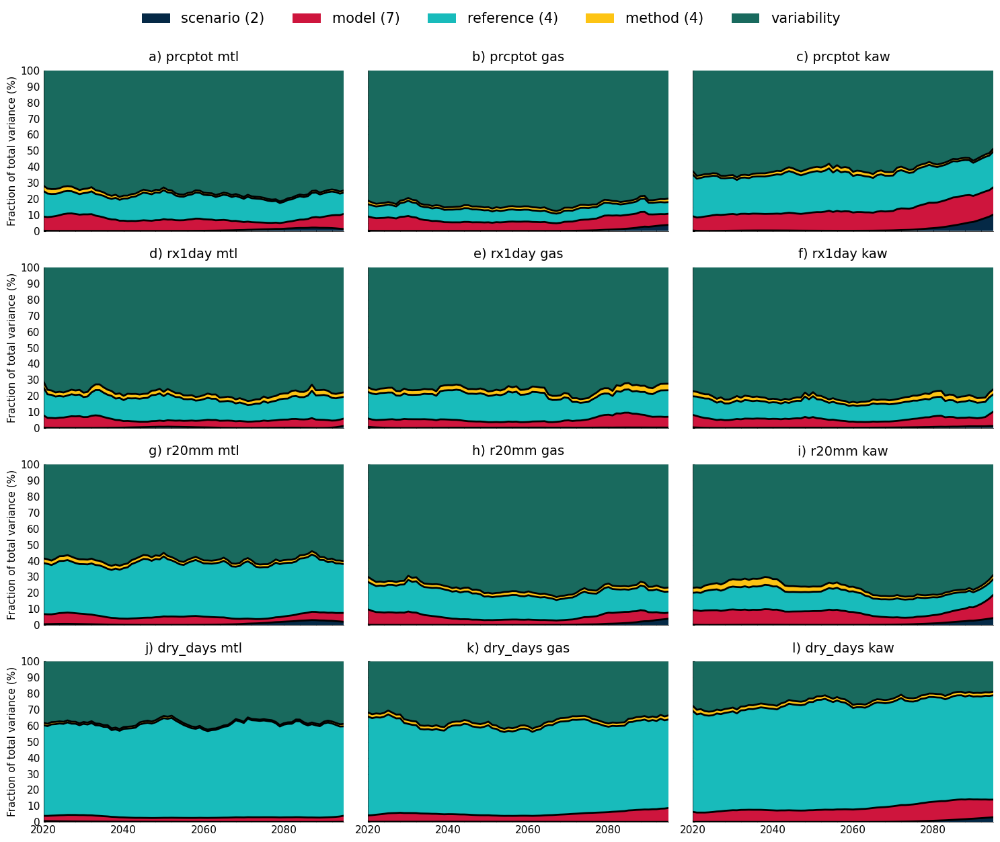

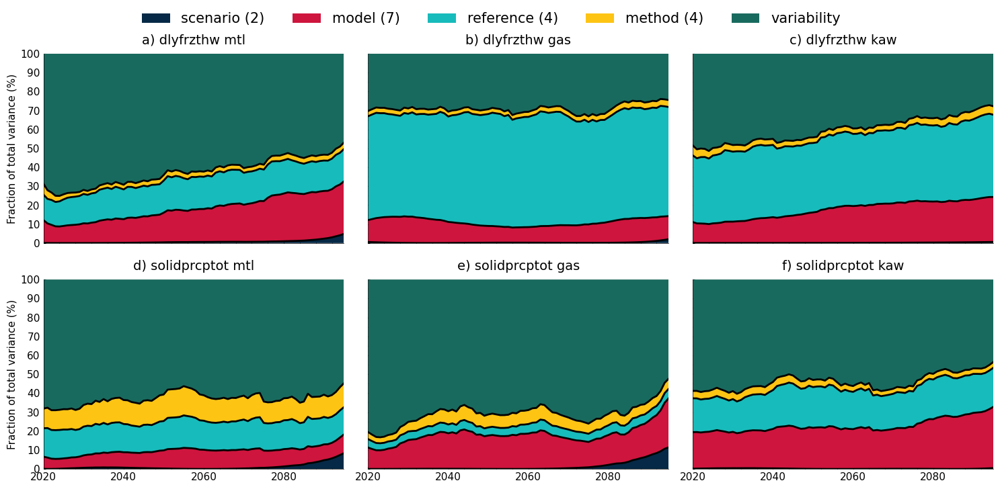

In [11]:
ens_name='7442'
#switch purple and green
matplotlib.rcParams['axes.prop_cycle'] = matplotlib.cycler(color=['#052946', '#ce153d', '#18bbbb', '#fdc414','#196a5e', '#6850af',  '#7a5315']) 

d_wrongorder=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain=['mtl','gas','kaw'] ).to_dataset_dict(**tdd)

#fix names
for k,v in d_wrongorder.items():
        v['uncertainty']=[categories[x] for x in v['uncertainty'].values]
        for c in categories:
            for var in v.data_vars:
                if c in v[var].attrs:
                    v[var].attrs[categories[c]]=v[var].attrs[c]
#fix order
d={f'CMIP6_ScenarioMIP_mtl.mtl.uncertainties{ens_name}-poly-2015.YS-JAN':d_wrongorder[f'CMIP6_ScenarioMIP_mtl.mtl.uncertainties{ens_name}-poly-2015.YS-JAN'],
   f'CMIP6_ScenarioMIP_gas.gas.uncertainties{ens_name}-poly-2015.YS-JAN':d_wrongorder[f'CMIP6_ScenarioMIP_gas.gas.uncertainties{ens_name}-poly-2015.YS-JAN'],
       f'CMIP6_ScenarioMIP_kaw.kaw.uncertainties{ens_name}-poly-2015.YS-JAN':d_wrongorder[f'CMIP6_ScenarioMIP_kaw.kaw.uncertainties{ens_name}-poly-2015.YS-JAN'],

  }
fig, axs= plt.subplots(3,3, figsize=(15,10), sharex=True, sharey=True)
for i, (id, ds) in enumerate(d.items()):
    domain=ds.attrs['cat:domain']
    for j, var in enumerate(['tg_mean','tx_max','tx_30']):
        frac= xc.ensembles.fractional_uncertainty(ds[var])

#             frac
        fg.partition(frac,show_num=True,ax=axs[j,i])
        axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {domain}")
        axs[j,i].get_legend().remove()
        axs[j,1].set_ylabel('')
        axs[j,2].set_ylabel('')
    
handles, labels = axs[j,i].get_legend_handles_labels()
labels=[x.replace('SSP','scenario').replace('GCM','model') for x in labels] # for reviewer
by_label = dict(zip(labels, handles)).copy()
fig.legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.85,1.05), ncol=5, fontsize=15)
fig.tight_layout()
#fig.savefig(f"{CONFIG['paths']['figures']}tas_unc.png", bbox_inches='tight')
fig.savefig(f"{CONFIG['paths']['figures']}/si/tas_unc_7442.pdf", bbox_inches='tight')


fig, axs= plt.subplots(4,3, figsize=(15,12), sharex=True, sharey=True)
for i, (id, ds) in enumerate(d.items()):
    domain=ds.attrs['cat:domain']
    for j, var in enumerate(['prcptot','rx1day', 'r20mm','dry_days']):
        frac= xc.ensembles.fractional_uncertainty(ds[var])
        fg.partition(frac,show_num=True,ax=axs[j,i])
        axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {domain}")
        axs[j,i].get_legend().remove()
        axs[j,1].set_ylabel('')
        axs[j,2].set_ylabel('')
    
handles, labels = axs[j,i].get_legend_handles_labels()
labels=[x.replace('SSP','scenario').replace('GCM','model') for x in labels] # for reviewer
by_label = dict(zip(labels, handles)).copy()
fig.legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.85,1.05), ncol=5, fontsize=15)
fig.tight_layout()
#fig.savefig(f"{CONFIG['paths']['figures']}pr_unc.png", bbox_inches='tight')
fig.savefig(f"{CONFIG['paths']['figures']}/si/pr_unc_7442.pdf", bbox_inches='tight')


fig, axs= plt.subplots(2,3, figsize=(15,7), sharex=True, sharey=True)
for i, (id, ds) in enumerate(d.items()):
    domain=ds.attrs['cat:domain']
    for j, var in enumerate(['dlyfrzthw','solidprcptot']): #
        frac= xc.ensembles.fractional_uncertainty(ds[var])
        fg.partition(frac,show_num=True,ax=axs[j,i])
        axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {domain}")
        axs[j,i].get_legend().remove()
        axs[j,1].set_ylabel('')
        axs[j,2].set_ylabel('')
        
handles, labels = axs[j,i].get_legend_handles_labels()
labels=[x.replace('SSP','scenario').replace('GCM','model') for x in labels] # for reviewer
by_label = dict(zip(labels, handles)).copy()
fig.legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.85,1.05), ncol=5, fontsize=15)
fig.tight_layout()
#fig.savefig(f"{CONFIG['paths']['figures']}multi_unc.png", bbox_inches='tight')
fig.savefig(f"{CONFIG['paths']['figures']}/si/multi_unc_7442.pdf", bbox_inches='tight')

/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "units" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "long_name" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "long_name" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "units" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "long_name" not found.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24

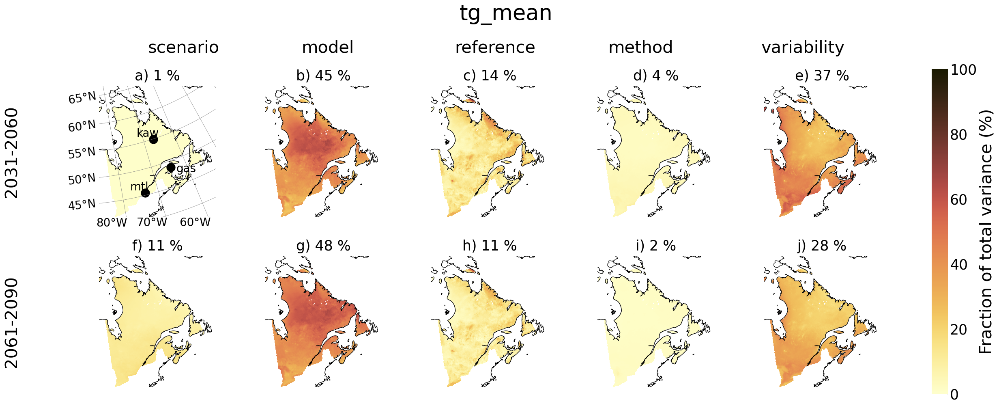

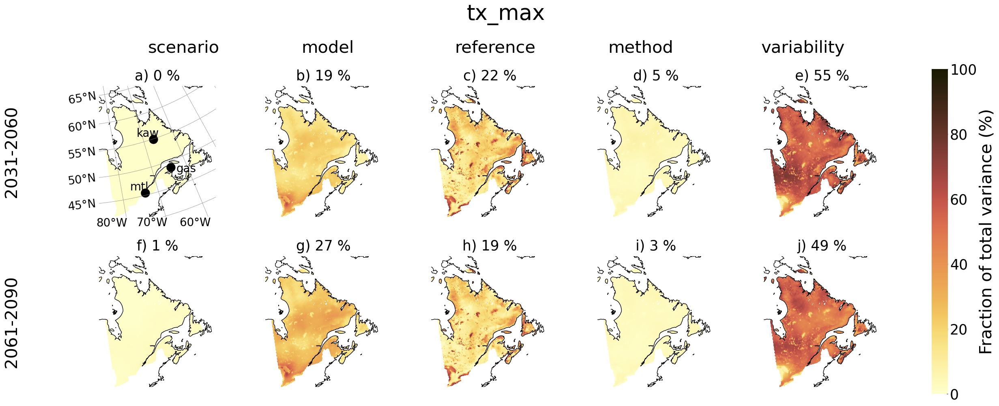

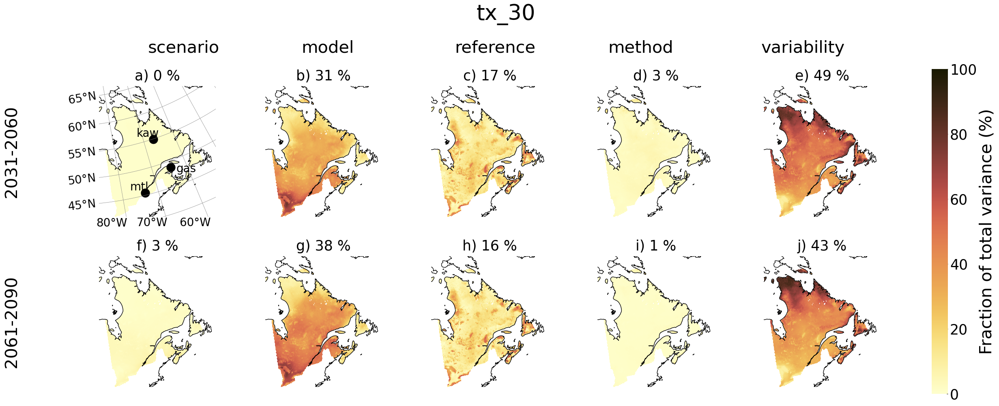

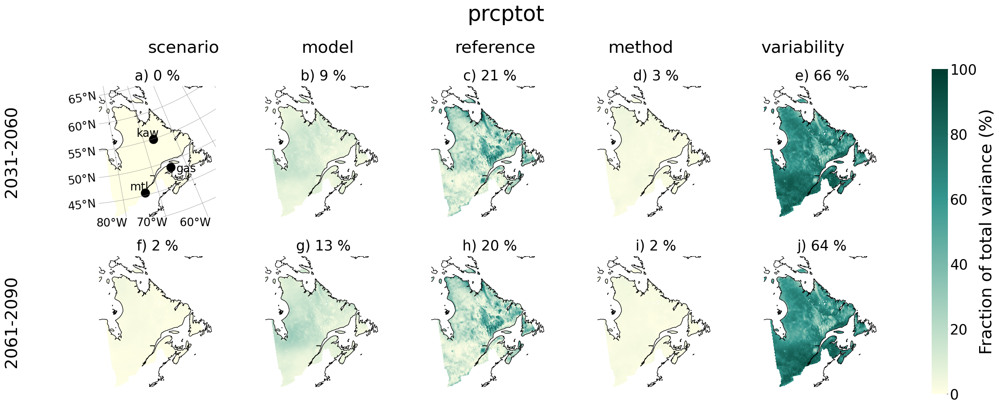

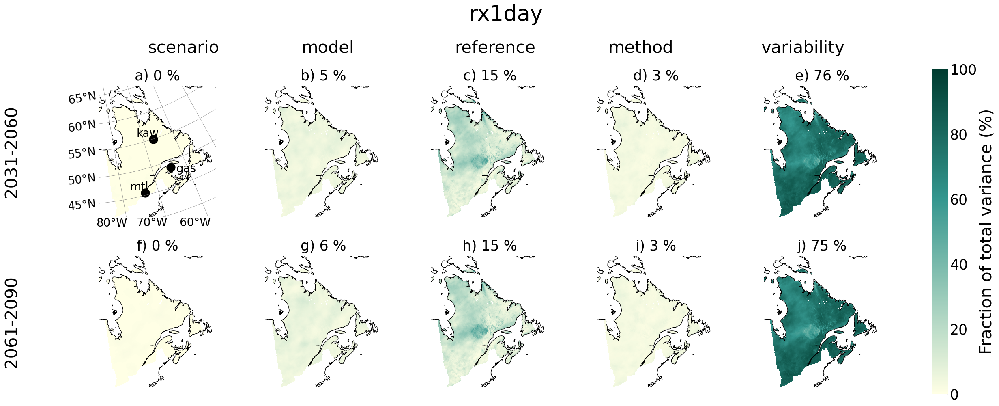

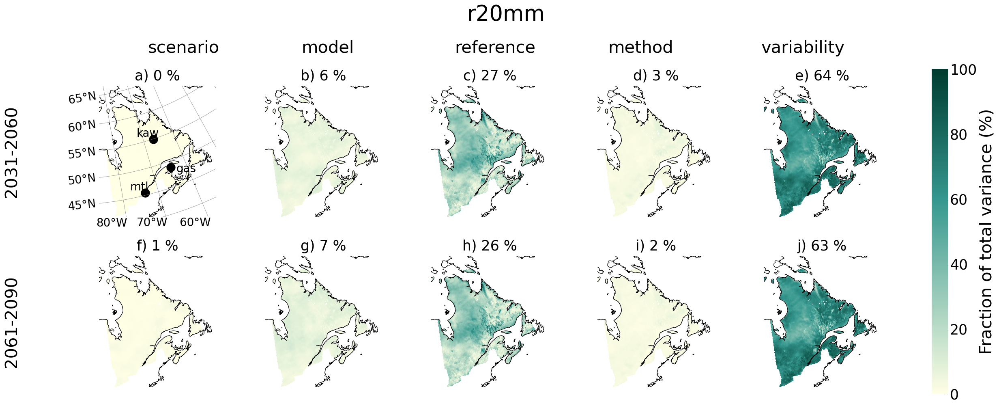

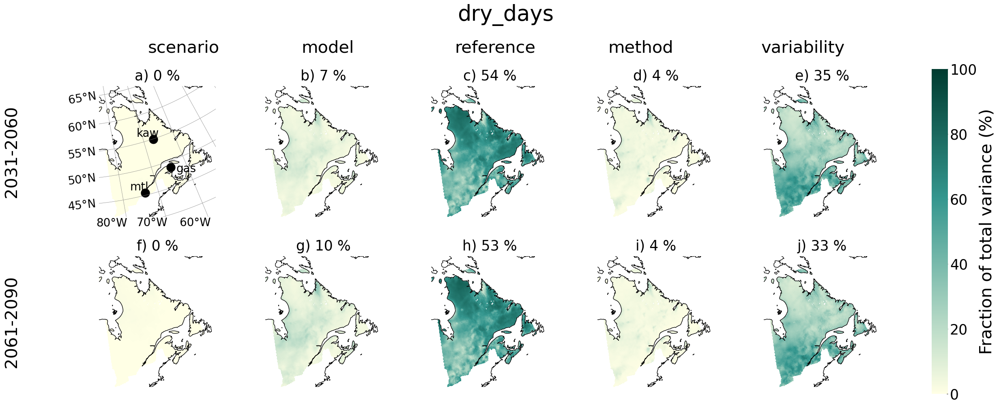

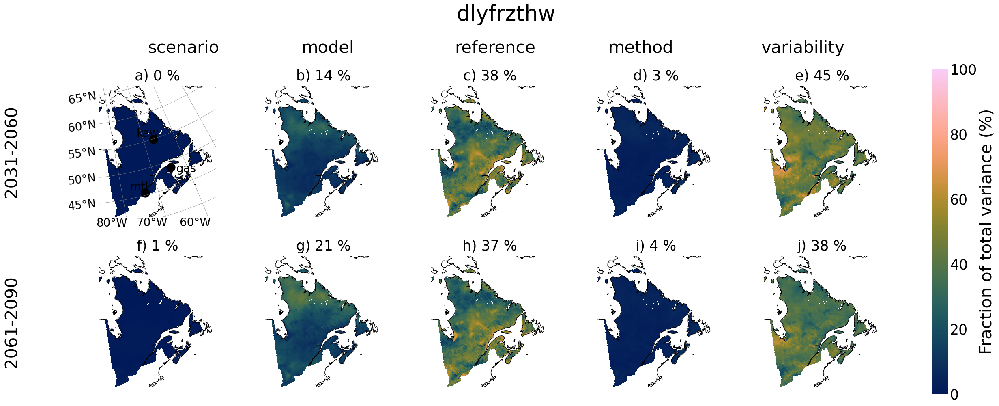

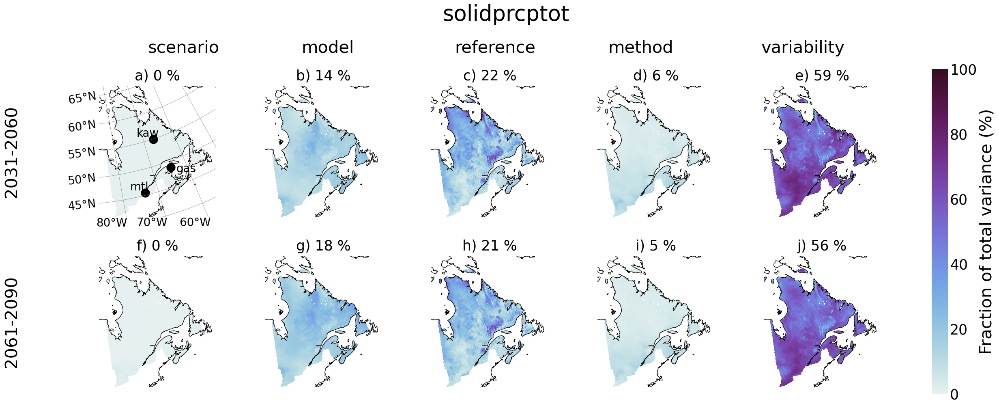

In [12]:
with Client(n_workers=3, threads_per_worker=5, memory_limit="8GB", **daskkws):
    for var in ['tg_mean','tx_max','tx_30','prcptot','rx1day', 'r20mm','dry_days','dlyfrzthw','solidprcptot']:
        ens_name='7442'
        ds=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain='QC-reg1c', variable=var).to_dataset(**tdd)
        ds['uncertainty']=[categories[x] for x in ds['uncertainty'].values]
        frac= xc.ensembles.fractional_uncertainty(ds).drop_sel(uncertainty='total')
        frac=xs.climatological_op(frac,op='mean', periods=[['2031','2060'],['2061','2090']],
                                 rename_variables=False, horizons_as_dim=True)#.compute()
        frac.lat.attrs['axis']='Y'
        frac.lon.attrs['axis']='X'
        frac.lat.attrs['axis']='Y'
        frac.lon.attrs['axis']='X'
        frac.lat.attrs['long_name'] = "latitude"
        frac.lat.attrs['standard_name'] = "latitude"
        frac.lon.attrs['long_name'] = "longitude"
        frac.lon.attrs['standard_name'] = "longitude"
        grid=fg.gridmap(frac[var],
                      features={'coastline':{},
                               },
                      cmap=cmaps[var],
                      projection=ccrs.LambertConformal(),
                      plot_kw={'col':'uncertainty','row':'horizon', 'vmin':0, 'vmax':100, #'figsize':(15,10),
                               'size':4, "aspect":1,
                               'cbar_kwargs':{'shrink':0.85},
                              },
                       )
        plt.subplots_adjust(hspace=0.3)
        grid.fig.suptitle(f"{var}",x=0.55, y=1.2, fontsize=38)
        y=1.05
        x=0.13
        dx=0.18
        means=[]
        for j,h in enumerate(frac.horizon.values):
            for i,t in enumerate(['SSP','GCM','reference','method','variability']):
                if j ==0:
                    grid.fig.text(s=t.replace('SSP','scenario').replace('GCM','model'),x=x+ i*dx, y=y, fontsize=30)
            
                spa_mean = xs.spatial_mean(frac[[var]].sel(uncertainty=t, horizon=h),method='xesmf',
                                           kwargs={'skipna':True},
                                          region= {'name': 'QC-mean','method': 'bbox',
                                                   'lon_bnds': [ -83, -55 ],'lat_bnds': [ 42, 63 ]})
                means.append("{:.0f} %".format(spa_mean[var].values))
        grid.cbar.set_label('Fraction of total variance (%)', fontsize=30)
        grid.cbar.ax.tick_params(labelsize=25)
        grid.cbar.ax.set_position([1.05, 0, 0.03, 1])

        # move labels to the left
        for i, fax in enumerate(grid.axs.flat):
            for txt in fax.texts:
                if len(txt.get_text()) > 0:
                    txt.set_x(-6.5)
                    txt.set_fontsize(30)
                    txt.set_rotation('vertical')
        for idx, ax in enumerate(grid.axs.flat):
            ax.set_title(f"{string.ascii_lowercase[idx]}) {means[idx]}", fontsize=25)

        grid.axs[0][0].plot(-73.6, 45.5, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-77.6, 46.6, 'mtl', fontsize=20, transform=ccrs.PlateCarree())
        grid.axs[0][0].plot(-64.5, 48.8, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-63.5, 47.56, 'gas', fontsize=20, transform=ccrs.PlateCarree())
        grid.axs[0][0].plot(-66.8, 54.9, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-71.9, 56.3, 'kaw', fontsize=20, transform=ccrs.PlateCarree())
        
        #grid.axs[0][0].set_extent([-80,-60, 45, 61], crs=ccrs.PlateCarree())

        gl=grid.axs[0][0].gridlines( draw_labels=True,color='gray',x_inline=False, y_inline=False)
        gl.xlabel_style = {'size': 20, 'rotation':0}
        gl.ylabel_style = {'size': 20}
        gl.top_labels = False
        gl.right_labels = False
        
        grid.fig.savefig(f"{CONFIG['paths']['figures']}/si/maps_{var}.png", bbox_inches='tight')
        #grid.fig.savefig(f"{CONFIG['paths']['figures']}maps_{var}_7442.pdf", bbox_inches='tight')



# reference timeseries (SI)


--> The keys in the returned dictionary of datasets are constructed as follows:
	'id.domain.processing_level.xrfreq'


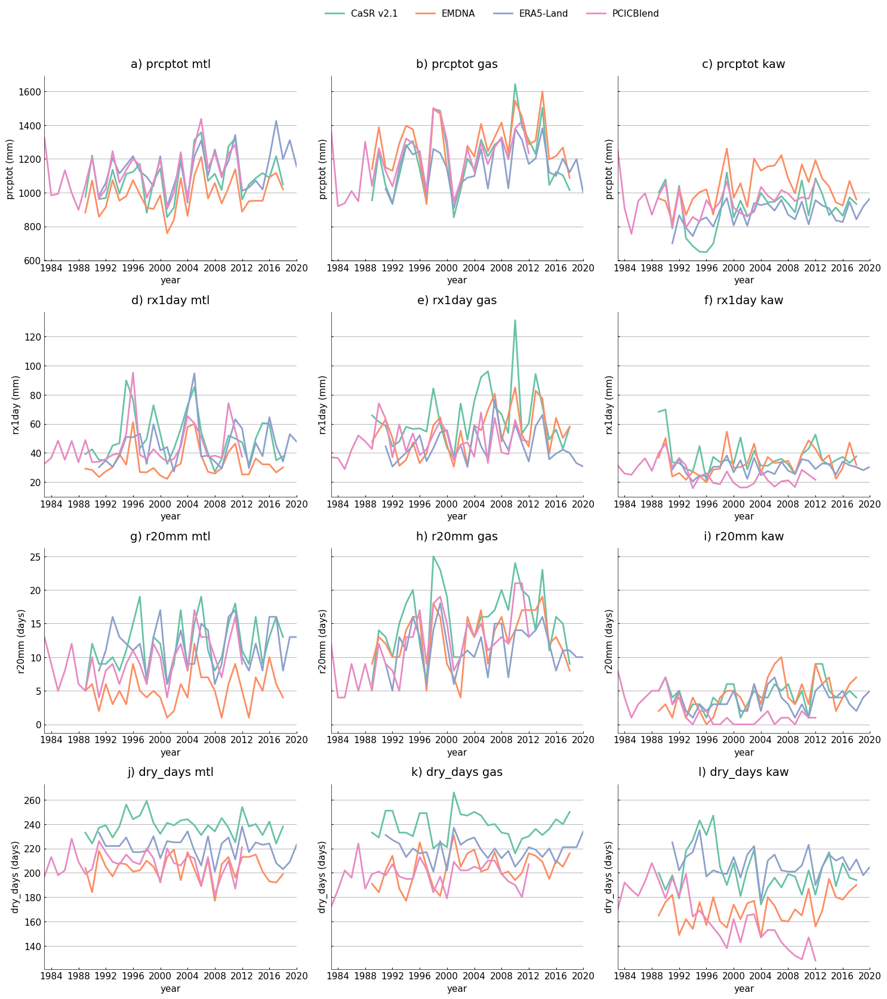

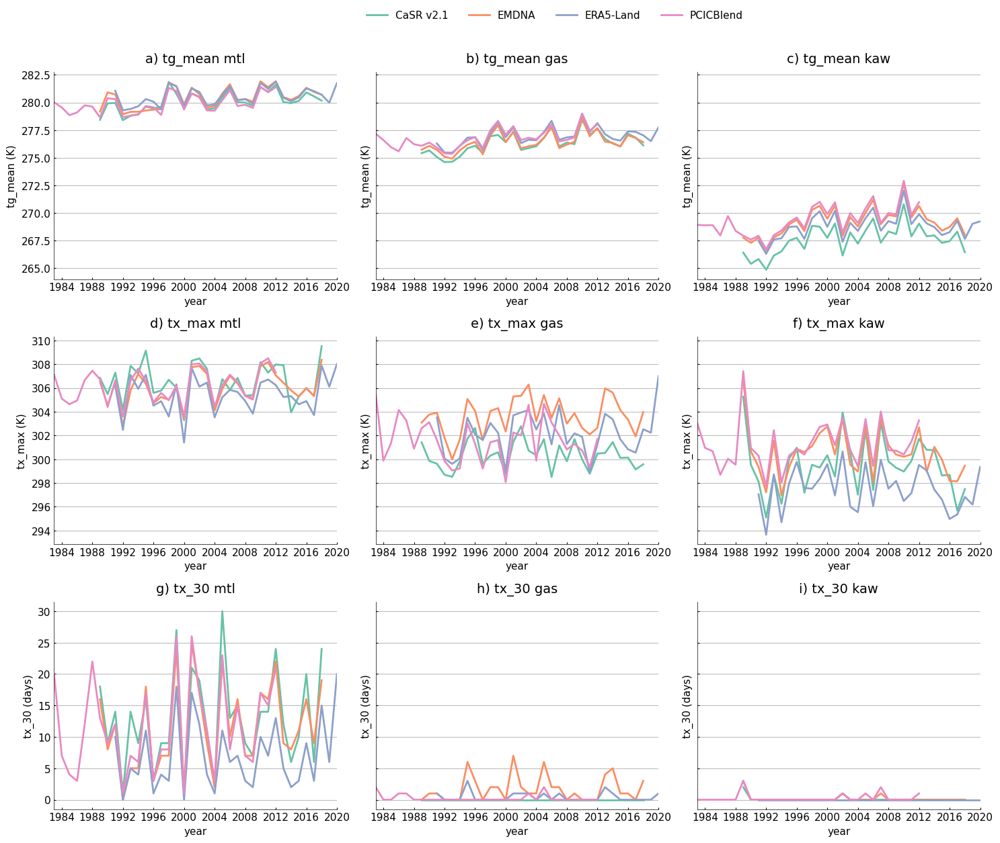

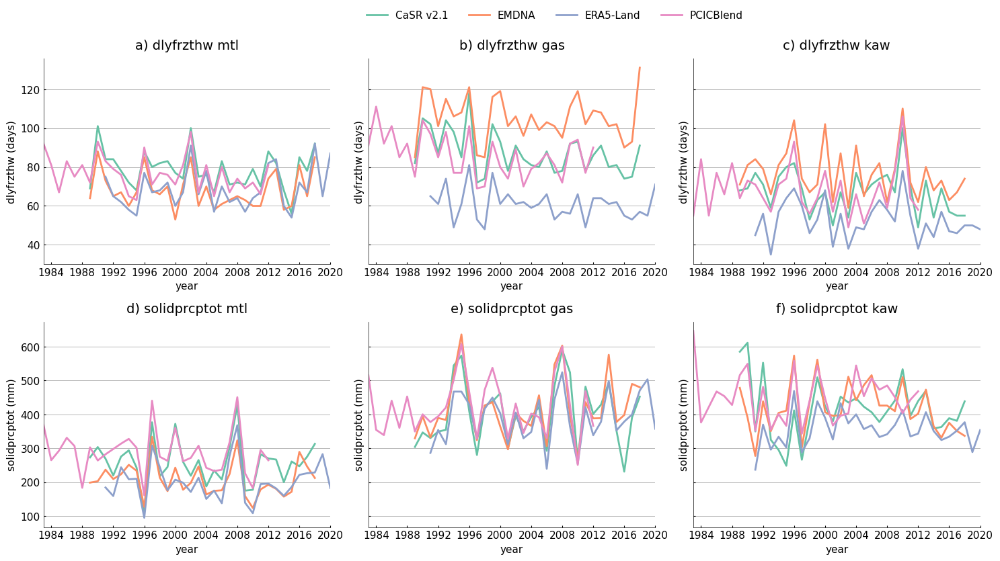

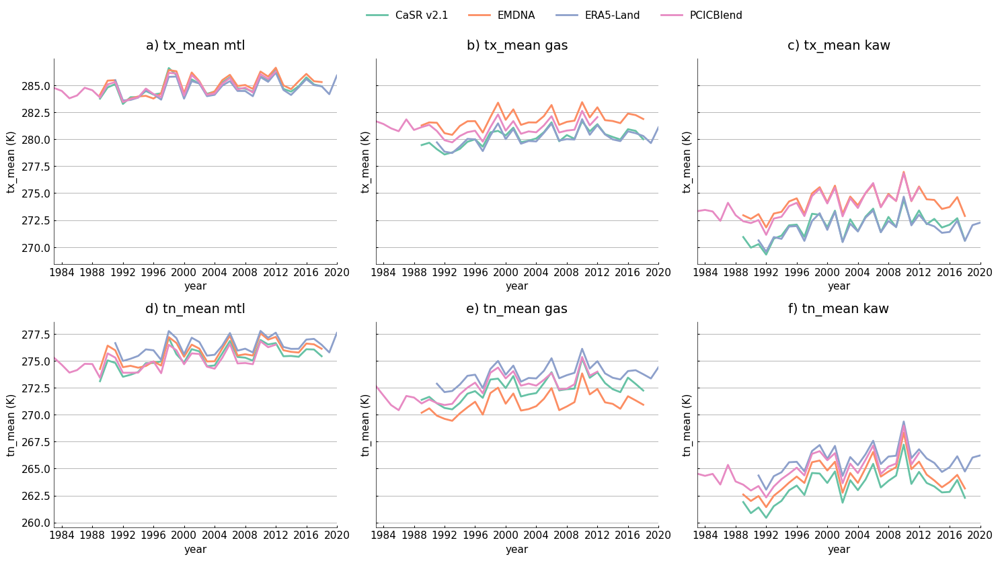

In [13]:

subcat = pcat.search(processing_level='indicators', bias_adjust_project='reference',
                             domain='QC',).to_dataset_dict(**CONFIG['tdd'])

all_var=[['prcptot', 'rx1day','r20mm','dry_days'], ['tg_mean', 'tx_max','tx_30'], ['dlyfrzthw', 'solidprcptot'],
         ['tx_mean','tn_mean']]
num_lines=4
cmap = sns.color_palette("Set2", as_cmap=True)

ls=['-','-.',':','--']
for variables in all_var:
    fs= (15,len(variables)*4)
    fig,axs= plt.subplots(len(variables),3,figsize=fs, sharex=True, sharey='row')

    for j,var in enumerate(variables):

        for n,ids in enumerate(['reference_GovCan_RDRS_QC.QC.indicators.YS-JAN',
                               'reference_USask_EMDNA_OI_QC.QC.indicators.YS-JAN',
                                'reference_ECMWF_ERA5-Land_QC.QC.indicators.YS-JAN',
                                'reference_PCIC_PCICBlend_QC.QC.indicators.YS-JAN'
                               ]):
            ds=subcat[ids]
            color=cmap(n)
            for i,(point, point_dict) in enumerate(CONFIG['gridpoints'].items()):
                da=xs.spatial.subset(ds[var],**point_dict)


                da.plot(label=ids.split("_")[2], ax=axs[j,i], color=color, linewidth=2)
                axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {point}")
                axs[j,i].set_ylabel(f"{var} ({da.attrs['units']})")
                axs[j,i].set_xlabel(f"year")
                axs[j,i].xaxis.set_tick_params(which='both', labelbottom=True)
        handles, labels =axs[j,i].get_legend_handles_labels()
        labels=[l.replace('RDRS', 'CaSR v2.1') for l in labels]
        fig.legend(handles, labels,bbox_to_anchor=(0.75,1.05),ncol=4)
        fig.tight_layout()
        
    fig.savefig(f"{CONFIG['paths']['figures']}/si/ref_ts_{variables[0]}.png", bbox_inches='tight')

In [14]:
# max diff btm ref
var='tx_max'
ds_c=pcat.search(processing_level='indicators', bias_adjust_project='reference', variable=var,source='RDRS',
                             domain='QC',).to_dataset(**CONFIG['tdd'])
da_c=xs.spatial.subset(ds_c[var],**CONFIG['gridpoints']['gas'])


ds_e=pcat.search(processing_level='indicators', bias_adjust_project='reference', variable=var,source='EMDNA',
                             domain='QC',).to_dataset(**CONFIG['tdd'])
da_e=xs.spatial.subset(ds_e[var],**CONFIG['gridpoints']['gas'])

diff=da_c-da_e

print(diff.mean(dim='time').values)

-3.3002014


In [15]:
# max diff btm ref
var='dlyfrzthw'
ds_c=pcat.search(processing_level='indicators', bias_adjust_project='reference', variable=var,source='ERA5-Land',
                             domain='QC',).to_dataset(**CONFIG['tdd'])
da_c=xs.spatial.subset(ds_c[var],**CONFIG['gridpoints']['gas'])


ds_e=pcat.search(processing_level='indicators', bias_adjust_project='reference', variable=var,source='EMDNA',
                             domain='QC',).to_dataset(**CONFIG['tdd'])
da_e=xs.spatial.subset(ds_e[var],**CONFIG['gridpoints']['gas'])

diff=da_c-da_e

print(diff.mean(dim='time').values)

-44.607142857142854


# reference maps of std (SI)

/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:1014: UserWarning: No spaces, points or colons to break line at.
/exec/easybuild/software/2023/x86-64-v3/Core/miniforge3/24.11.3-0/envs/xscen-0.12/lib/python3.12/site-packages/figanos/matplotlib/utils.py:1014: UserWarning: No spaces, points or colons to break line at.


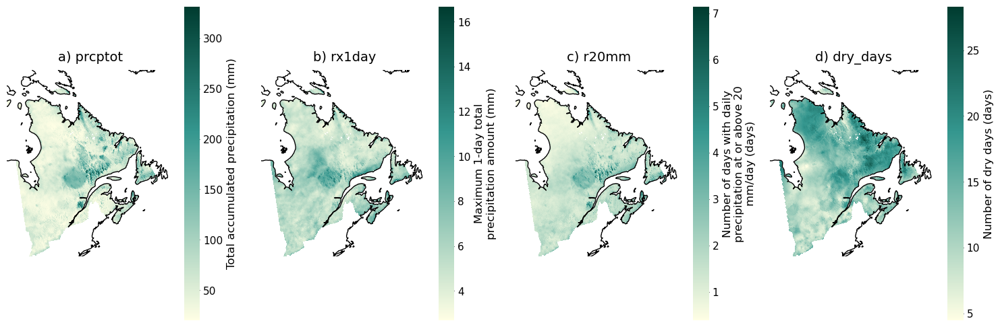

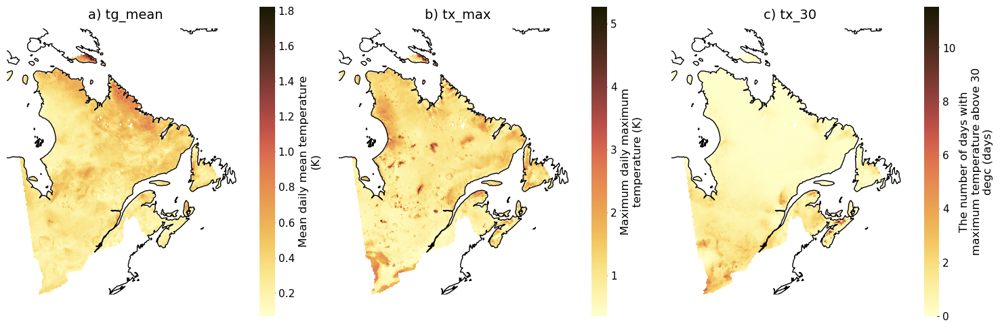

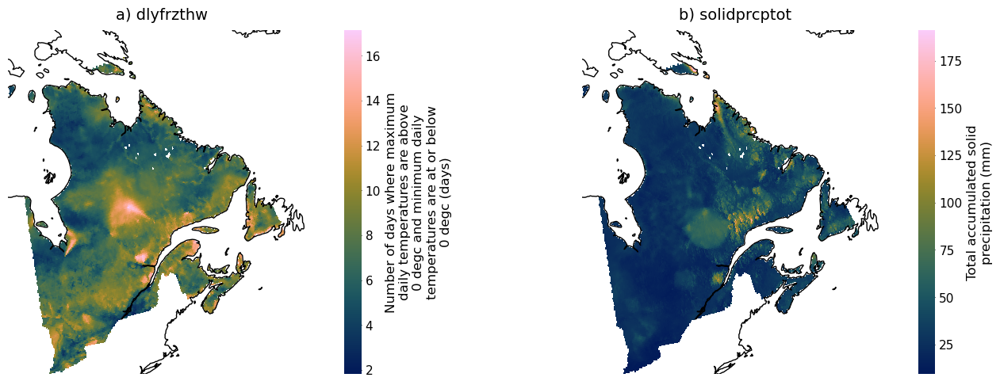

In [16]:
with plt.rc_context({'axes.labelsize':12}):

    refs=[]
    for s in ['RDRS', 'EMDNA','ERA5-Land','PCICBlend']:
        cur=pcat.search(bias_adjust_project='reference',domain='QC-reg1c', source=s).to_dataset(**tdd)
        cur=cur.expand_dims({'source':[s]})
        refs.append(cur)
    ds=xr.concat(refs, dim='source')
    #ds=xs.spatial.subset(ds, method='shape',shape="region_qc/region_qc.shp").drop_vars('crs')


    all_var=[['prcptot', 'rx1day','r20mm','dry_days'], ['tg_mean', 'tx_max','tx_30'], ['dlyfrzthw', 'solidprcptot'],]
    for variables, cmap in zip(all_var, ['prec_seq','temp_seq','misc_seq_3','temp_seq']):
        fig,axs= plt.subplots(1,len(variables),figsize=(15,5),subplot_kw={'projection': ccrs.LambertConformal()}) 
        for i, var in enumerate(variables):
            a=fg.gridmap(ds[var].std(dim='source',keep_attrs=True).mean(dim='time',keep_attrs=True),
                       ax=axs[i],cmap=cmap, features=['coastline'],
                      )
            axs[i].set_title(f"{string.ascii_lowercase[i]}) {var}")
        fig.tight_layout()
        fig.savefig(f"{CONFIG['paths']['figures']}/si/ref_map_std_{variables[0]}.png", bbox_inches='tight')

# stations (SI)

found 1970 station descriptions... filtering 


/exec/jlavoie/.conda/envs/partition/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "units" not found.
/exec/jlavoie/.conda/envs/partition/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "long_name" not found.
/exec/jlavoie/.conda/envs/partition/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "description" not found.


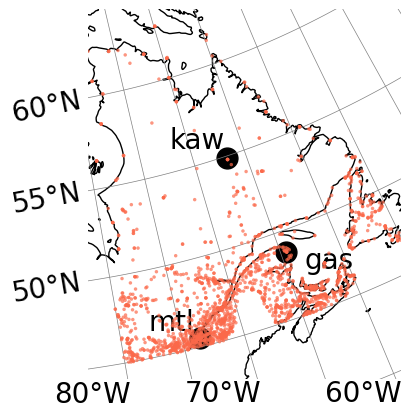

In [21]:
import urllib
import geopandas as gpd

#use a bounding box to limit zone of interest
lat_bnds = [45, 65]
lon_bnds = [-80, -55]

freq = 'HLY'

# Compose the request
#url = URL(f"https://api.weather.gc.ca/collections/climate-stations/items?&limit=1500000000&bbox={min(lon_bnds)},{min(lat_bnds)},{max(lon_bnds)},{max(lat_bnds)}")
url=f"https://api.weather.gc.ca/collections/climate-stations/items?&limit=1500000000&bbox={min(lon_bnds)},{min(lat_bnds)},{max(lon_bnds)},{max(lat_bnds)}"

# # Send the request to the server
#resp = url.get()
# resp
with urllib.request.urlopen(url=str(url)) as req:
    stations = gpd.read_file(filename=req).to_crs('epsg:4326')

print(f'found {len(stations)} station descriptions... filtering ')
stations['lon'] = stations.geometry.x
stations['lat'] = stations.geometry.y
dsC = xr.Dataset.from_dataframe(stations)
dsC = dsC.set_coords(['lat', 'lon'])


dsC_qc= xs.spatial.subset(dsC, method='bbox',name='qc',lon_bnds= [ -83, -55 ],lat_bnds= [ 42, 63 ])
dsC_qc['STN_ID']=dsC_qc['STN_ID'].where(dsC_qc['STN_ID']<0, 1)
ax=fg.scattermap(dsC_qc['STN_ID'],
              features=['coastline'],
            projection=ccrs.LambertConformal(),
              cmap='Reds',
              plot_kw={'s':25, 'marker':'.','vmin':0,'vmax':5,"add_colorbar":False,'alpha':0.7}
             )
ax.plot(-73.6, 45.5, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
ax.text(-77.6, 46.6, 'mtl', fontsize=20, transform=ccrs.PlateCarree())
ax.plot(-64.5, 48.8, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
ax.text(-63.5, 47.56, 'gas', fontsize=20, transform=ccrs.PlateCarree())
ax.plot(-66.8, 54.9, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
ax.text(-71.9, 56.3, 'kaw', fontsize=20, transform=ccrs.PlateCarree())



        
#ax.set_extent([-80,-60, 45, 61], crs=ccrs.PlateCarree())

gl=ax.gridlines( draw_labels=True,color='gray',x_inline=False, y_inline=False)
gl.xlabel_style = {'size': 20, 'rotation':0}
gl.ylabel_style = {'size': 20}
gl.top_labels = False
gl.right_labels = False

plt.savefig(f"{CONFIG['paths']['figures']}/si/stations.png", bbox_inches='tight')


# return period

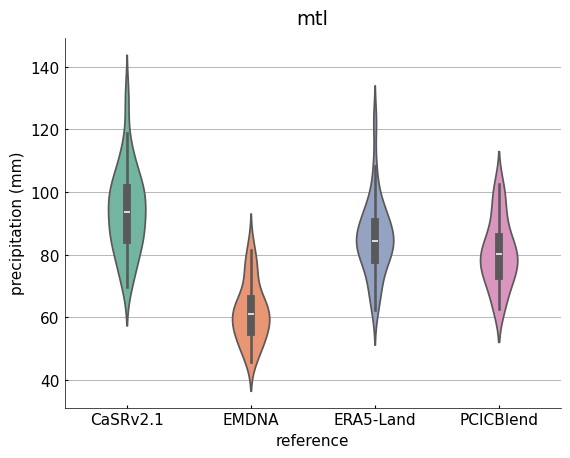

In [18]:
var='pr'
def drop_lat_lon(ds):
    return ds.drop_vars(['lat','lon'])
point_name='mtl'
point in CONFIG['gridpoints'][point_name]
datasets=pcat.search(processing_level='returnlevel20',
                           domain=point_name,
                           )



ens_part = xs.ensembles.build_partition_data(
    datasets,
    partition_dim=["source", "experiment", "adjustment", 'reference'],
)
#display(ens_part)
df = ens_part[var].to_dataframe(name=var).reset_index()
plt.figure()
sns.violinplot(x='reference', y='pr', data=df,width=0.3,
               order=['CaSRv2.1','EMDNA','ERA5-Land','PCICBlend'],
               palette="Set2",
               hue='reference',legend=False);
plt.title(point_name)
plt.ylabel('precipitation (mm)')
plt.savefig(f"{CONFIG['paths']['figures']}/si/return_level.png", bbox_inches='tight')


# not shown

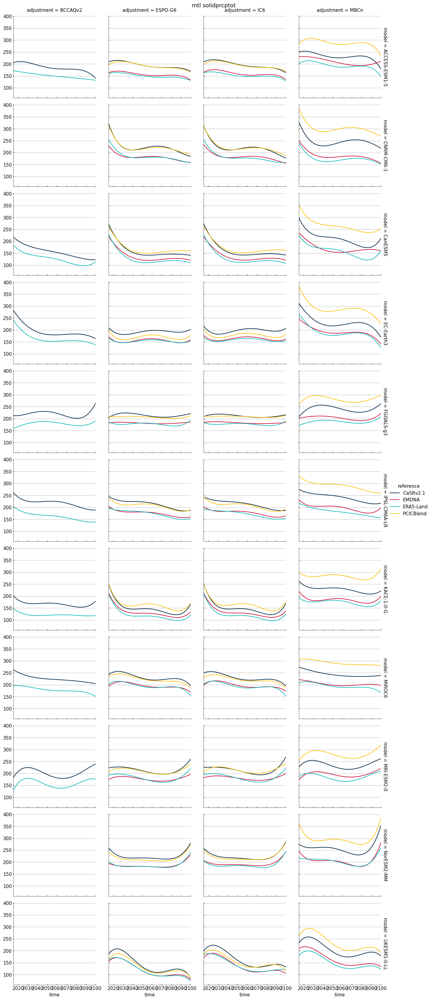

In [19]:
# MBCn drive diff in solidprcptot
point='mtl'
point_dict=CONFIG['gridpoints'][point]
ens_part = pcat.search(processing_level='partition-ensemble11444', domain=point).to_dataset(**tdd)
for var in ['solidprcptot']:
    da=ens_part[var]

    fit = da.polyfit(dim="time", deg=4, skipna=True)
    sm = xr.polyval(coord=da.time, coeffs=fit.polyfit_coefficients).where(
        da.notnull()
    )
    grid=sm.isel(scenario=0).plot(row='model',hue='reference', col='adjustment')
    grid.fig.suptitle(f"{point} {var}", y=1)
